<a href="https://colab.research.google.com/github/butlerbt/SegmentingBuildings/blob/colab/tier1_batch_processing_colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
#mount drive
from google.colab import drive 
drive.mount('/content/drive/')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive/


In [2]:
#enable Google Drive to be used to host .py modules
!pip install pydrive                             # Package to use Google Drive API - not installed in Colab VM by default
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth                    # Other necessary packages
from oauth2client.client import GoogleCredentials
auth.authenticate_user()                         # Follow prompt in the authorization process


In [9]:
#make gdal adjustments for solaris installation 
!add-apt-repository ppa:ubuntugis/ubuntugis-unstable -y
!apt-get update
!apt-get install python-numpy gdal-bin libgdal-dev python3-rtree
!apt install python3-rtree

#intall libraires to colab runtime 
!pip install solaris
!pip install rasterio
!pip install geopandas
!pip install descartes
!pip install solaris
!pip install rio-tiler

Ign:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Ign:2 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Get:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release [564 B]
Get:4 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release [564 B]
Get:5 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release.gpg [833 B]
Get:6 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release.gpg [833 B]
Get:7 http://ppa.launchpad.net/graphics-drivers/ppa/ubuntu bionic InRelease [21.3 kB]
Get:8 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Get:9 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Packages [132 kB]
Hit:10 http://archive.ubuntu.com/ubuntu bionic InRelease
Get:11 https://developer.download.nvidia.com/compute/machine-

     |████████████████████████████████| 112kB 2.8MB/s 
  Created wheel for rio-tiler: filename=rio_tiler-1.3.1-cp36-none-any.whl size=172294 sha256=8a4a537efbf870697cab67fe661b39abf89e086c41c4da6acefa22c8ba9494ae
  Stored in directory: /root/.cache/pip/wheels/13/0f/f0/2e7e21b2aeaa99791322cdd28262bbf3da097d24a4bf640f47
  Created wheel for rio-toa: filename=rio_toa-0.3.0-cp36-none-any.whl size=12429 sha256=e898e688f448681b7914c5b6cfea920dce095fd9c2eefc1a47016e591ad39409
  Stored in directory: /root/.cache/pip/wheels/12/25/52/036fe06fa14768bf5e4eef4abd4beccb3924b695199f1721a2
Successfully built rio-tiler rio-toa


In [14]:
!pip install solaris


In [0]:
#import .py files from drive as modules to access functions
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)
proc_module = drive.CreateFile({"id": "1--h2VnE_DwDVv7XHddmzSYHtOrp0OlNH"})   # "your_module_file_id" is the part after "id=" in the shareable link
proc_module.GetContentFile("processing_colab2.py") # Save the .py module file to Colab VM
vis_module = drive.CreateFile({"id":"1fR6zXs-_EpjWxP6x_Mff42bMWC_ZB_50"})   
vis_module.GetContentFile("visualization.py")  
import visualization as vis         
import processing_colab2 as proc                                    # Ready to import. Don't include".py" part, of course :)

In [0]:
!rm -rf drive/My\ Drive/seg_building_foots/data/processed/*

In [7]:
#download the full set of train_tier_1 data
!wget https://drivendata-public-assets-eu.s3.eu-central-1.amazonaws.com/train_tier_1.tgz
!tar -xvzf train_tier_1.tgz 
!rm train_tier_1.tgz

--2020-01-30 17:46:43--  https://drivendata-public-assets-eu.s3.eu-central-1.amazonaws.com/train_tier_1.tgz
Resolving drivendata-public-assets-eu.s3.eu-central-1.amazonaws.com (drivendata-public-assets-eu.s3.eu-central-1.amazonaws.com)... 52.219.75.13
Connecting to drivendata-public-assets-eu.s3.eu-central-1.amazonaws.com (drivendata-public-assets-eu.s3.eu-central-1.amazonaws.com)|52.219.75.13|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 32379673093 (30G) [application/x-tar]
Saving to: ‘train_tier_1.tgz’

train_tier_1.tgz     33%[=====>              ]   9.97G   309KB/s    in 15m 36s 

2020-01-30 18:07:22 (10.9 MB/s) - Read error at byte 10709356043/32379673093 (Connection reset by peer). Retrying.

--2020-01-30 18:07:23--  (try: 2)  https://drivendata-public-assets-eu.s3.eu-central-1.amazonaws.com/train_tier_1.tgz
Connecting to drivendata-public-assets-eu.s3.eu-central-1.amazonaws.com (drivendata-public-assets-eu.s3.eu-central-1.amazonaws.com)|52.219.75.13|

In [140]:
#Get file paths for batch processing
zoom_level = 19
tif_file_df, label_file_df = proc.file_path_df_colab(1) 


Found  31 images
Found 31 labels





!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 ptn
 abe1a3
 iteration 0
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

2it [00:00, 15.36it/s]

3it [00:00, 11.39it/s]

5it [00:00, 11.20it/s]

6it [00:00,  9.11it/s]

7it [00:00,  8.11it/s]

8it [00:00,  7.15it/s]

10it [00:01,  7.88it/s]

11it [00:01,  6.33it/s]

12it [00:01,  6.24it/s]

13it [00:01,  6.41it/s]

14it [00:01,  6.47it/s]

15it [00:02,  6.30it/s]

17it [00:02,  7.22it/s]

18it [00:02,  6.56it/s]

19it [00:02,  6.43it/s]

20it [00:02,  6.19it/s]

21it [00:02,  6.19it/s]

22it [00:03,  6.32it/s]

23it [00:03,  6.33it/s]

24it [00:03,  6.51it/s]

26it [00:03,  7.45it/s]

27it [00:03,  7.33it/s]

28it [00:03,  7.43it/s]

29it [00:03,  7.41it/s]

30it [00:04,  7.73it/s]

31it [00:04,  7.48it/s]

32it [00:04,  7.53it/s]

33it [00:04,  7.51it/s]

34it [00:04,  7.77it/s]

35it [00:04,  7.42it/s]

37it [00:04,  8.03it/s]

38it [00:05,  7.69it/s]

39it [00:05,  7.06it/s]

40it [00:05,  6.81it/s]

41it [00:05,  6.71it/s]

42it [00:05,  6.95it/s]

43it [00:05,  6.66it/s]

44it [00:05,  6.55it/s]

45it [00:06,  6.14it/s]

46it [00:

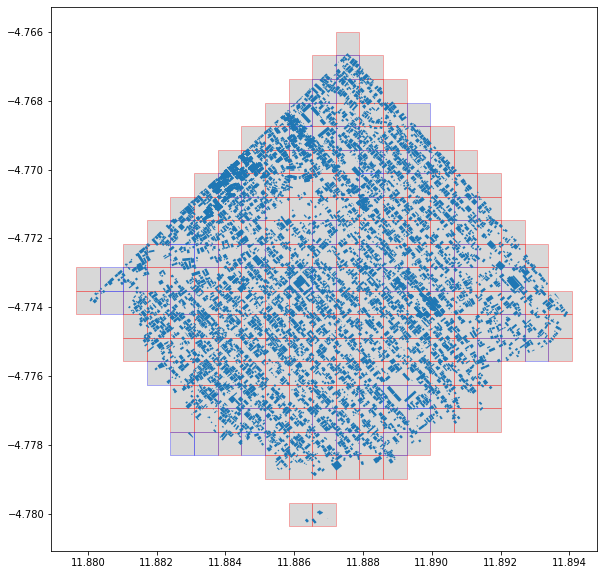

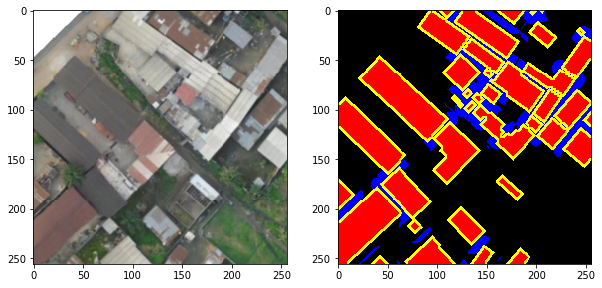

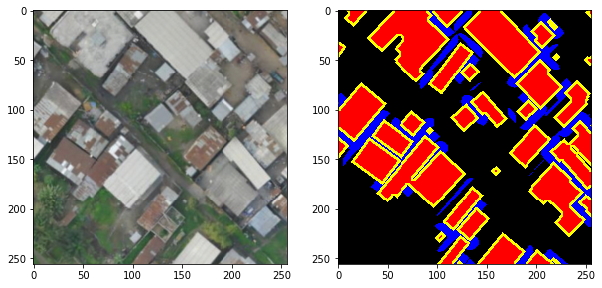

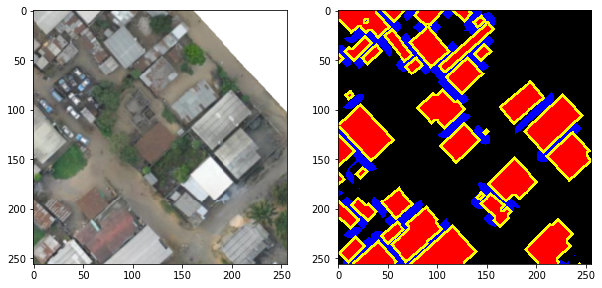

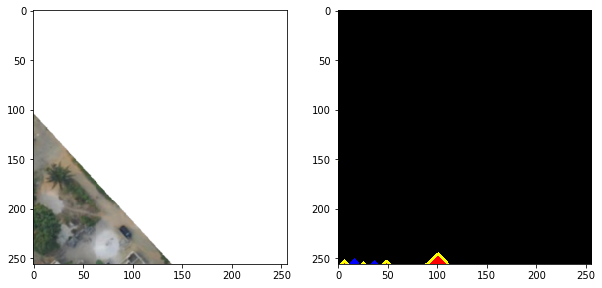

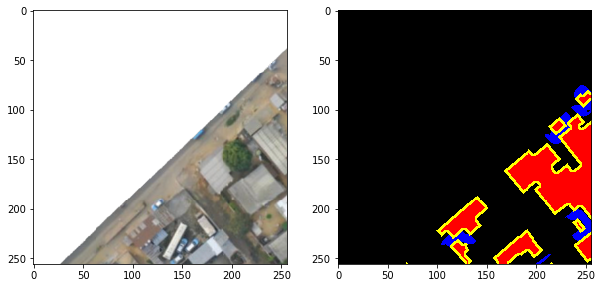




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 ptn
 f49f31
 iteration 1
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

1it [00:00,  9.77it/s]

2it [00:00,  9.82it/s]

4it [00:00,  8.98it/s]

5it [00:00,  8.13it/s]

6it [00:00,  8.12it/s]

7it [00:00,  7.33it/s]

8it [00:01,  7.04it/s]

9it [00:01,  6.84it/s]

10it [00:01,  7.02it/s]

11it [00:01,  6.95it/s]

13it [00:01,  7.36it/s]

14it [00:01,  7.18it/s]

15it [00:02,  7.51it/s]

16it [00:02,  7.36it/s]

17it [00:02,  7.34it/s]

18it [00:02,  7.24it/s]

19it [00:02,  7.54it/s]

20it [00:02,  7.81it/s]

21it [00:02,  7.76it/s]

23it [00:02,  9.06it/s]

24it [00:03,  7.86it/s]

25it [00:03,  6.62it/s]

26it [00:03,  6.50it/s]

27it [00:03,  6.05it/s]

28it [00:03,  5.77it/s]

29it [00:04,  5.84it/s]

30it [00:04,  5.99it/s]

31it [00:04,  6.15it/s]

32it [00:04,  6.31it/s]

33it [00:04,  6.46it/s]

35it [00:04,  7.64it/s]

36it [00:04,  7.05it/s]

37it [00:05,  6.55it/s]

38it [00:05,  6.51it/s]

39it [00:05,  6.20it/s]

40it [00:05,  5.91it/s]

41it [00:05,  5.89it/s]

42it [00:05,  6.31it/s]

43it [00:06,  6.29it/s]

44it [00:06

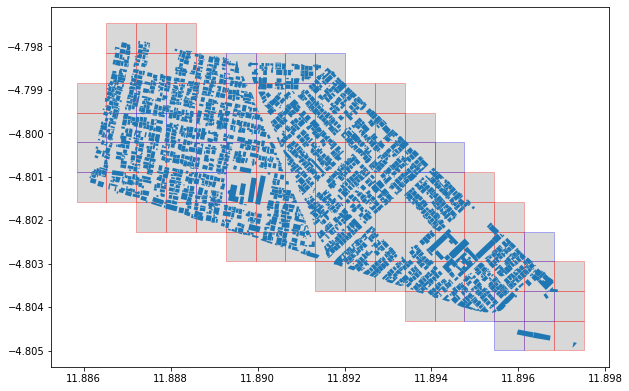

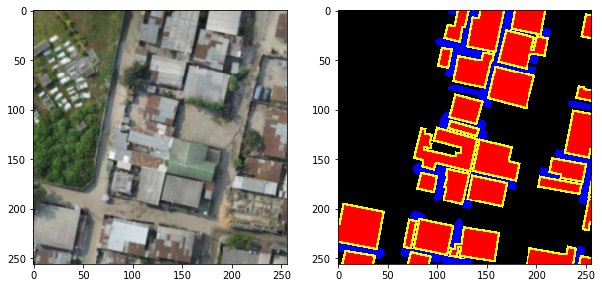

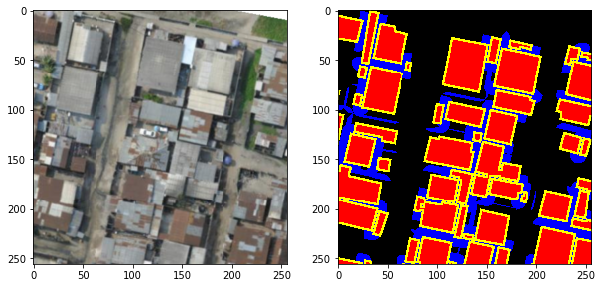

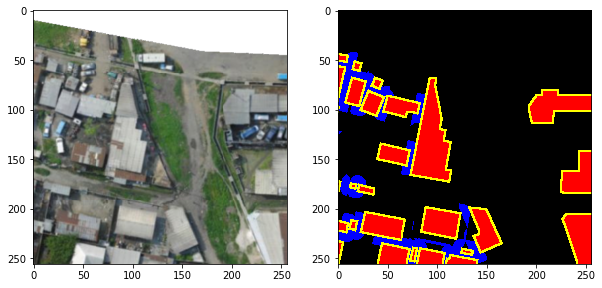

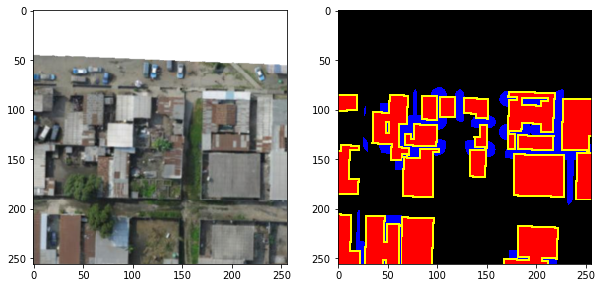

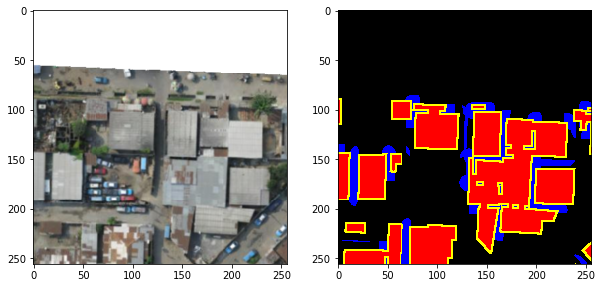




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 076995
 iteration 2
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

1it [00:00,  9.59it/s]

2it [00:00,  9.33it/s]

3it [00:00,  9.29it/s]

4it [00:00,  9.02it/s]

5it [00:00,  9.02it/s]

6it [00:00,  7.71it/s]

7it [00:00,  7.80it/s]

8it [00:00,  8.06it/s]

9it [00:01,  8.26it/s]

10it [00:01,  8.68it/s]

12it [00:01,  9.03it/s]

13it [00:01,  8.82it/s]

14it [00:01,  8.49it/s]

15it [00:01,  8.62it/s]

16it [00:01,  8.92it/s]

17it [00:01,  8.50it/s]

18it [00:02,  8.41it/s]

19it [00:02,  8.02it/s]

20it [00:02,  8.37it/s]

21it [00:02,  8.61it/s]

22it [00:02,  8.82it/s]

23it [00:02,  8.82it/s]

24it [00:02,  8.76it/s]

25it [00:02,  8.63it/s]

26it [00:03,  8.64it/s]

27it [00:03,  8.67it/s]

28it [00:03,  8.38it/s]

29it [00:03,  8.37it/s]

30it [00:03,  8.54it/s]

31it [00:03,  8.56it/s]

32it [00:03,  8.87it/s]

33it [00:03,  8.49it/s]

34it [00:03,  8.50it/s]

35it [00:04,  8.02it/s]

36it [00:04,  7.93it/s]

37it [00:04,  8.04it/s]

38it [00:04,  8.25it/s]

39it [00:04,  8.17it/s]

40it [00:04,  8.23it/s]

41it [00:04,

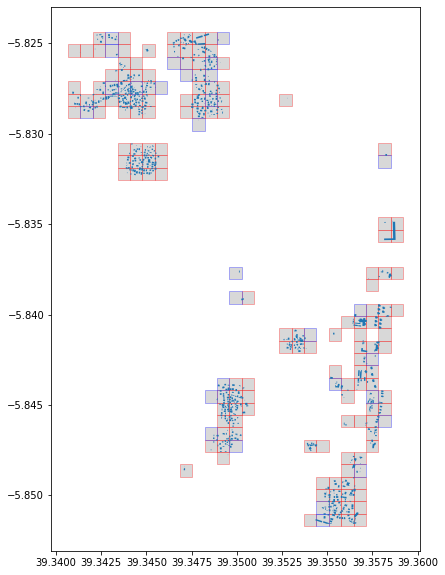

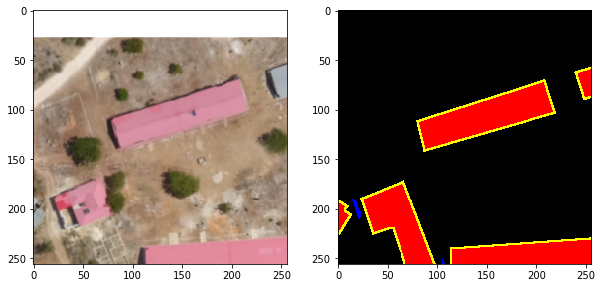

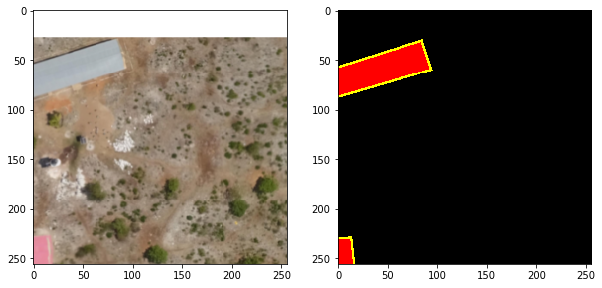

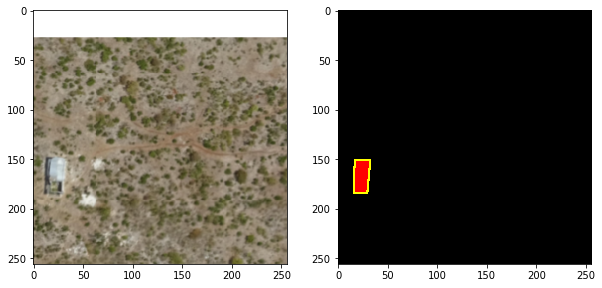

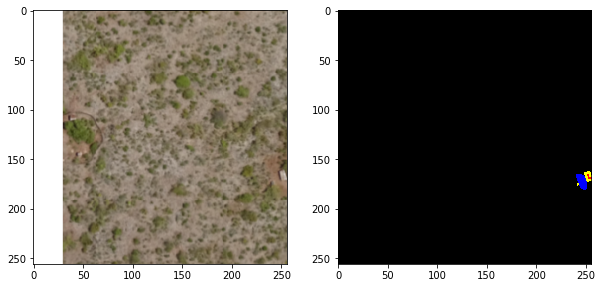

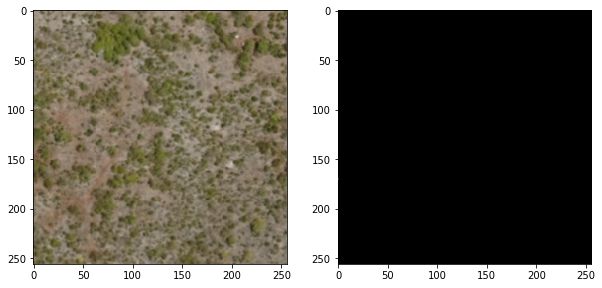




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 c7415c
 iteration 3
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

2it [00:00, 16.16it/s]

4it [00:00, 15.31it/s]

6it [00:00, 15.33it/s]

8it [00:00, 14.52it/s]

10it [00:00, 13.36it/s]

12it [00:00, 12.00it/s]

14it [00:01, 10.71it/s]

15it [00:01, 10.47it/s]

16it [00:01,  8.87it/s]

17it [00:01,  8.35it/s]

18it [00:01,  5.44it/s]

19it [00:02,  6.18it/s]

20it [00:02,  6.00it/s]

21it [00:02,  6.64it/s]

22it [00:02,  7.29it/s]

23it [00:02,  7.53it/s]

25it [00:02,  7.95it/s]

26it [00:02,  7.92it/s]

27it [00:03,  7.77it/s]

28it [00:03,  8.12it/s]

29it [00:03,  8.04it/s]

30it [00:03,  8.42it/s]

31it [00:03,  8.81it/s]

32it [00:03,  8.81it/s]

33it [00:03,  8.38it/s]

34it [00:03,  7.96it/s]

35it [00:03,  8.25it/s]

36it [00:04,  8.37it/s]

37it [00:04,  8.65it/s]

38it [00:04,  8.73it/s]

39it [00:04,  8.21it/s]

40it [00:04,  8.34it/s]

41it [00:04,  8.16it/s]

42it [00:04,  7.03it/s]

43it [00:04,  7.62it/s]

44it [00:05,  7.92it/s]

45it [00:05,  8.13it/s]

46it [00:05,  8.57it/s]

47it [00:05,  8.45it/s]

48it [0

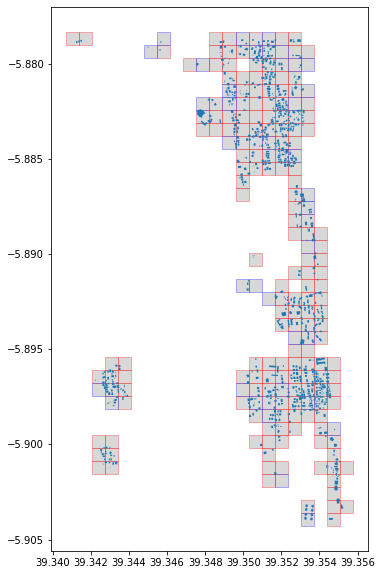

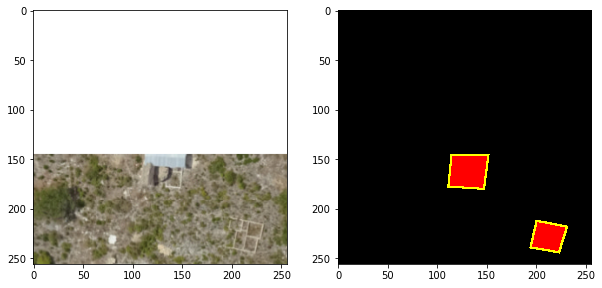

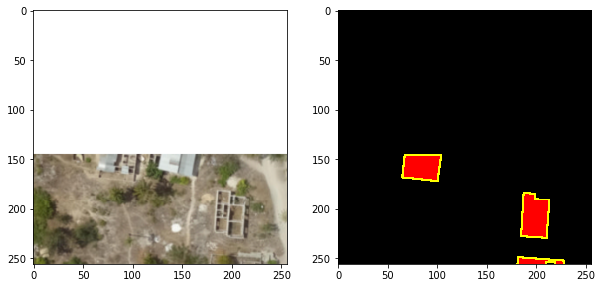

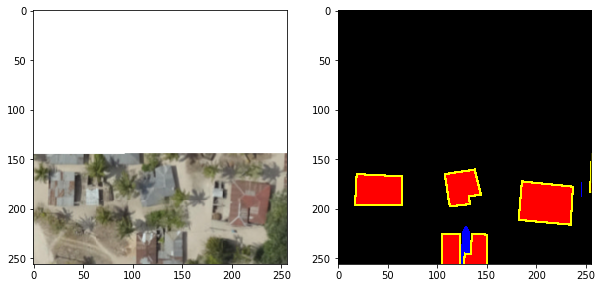

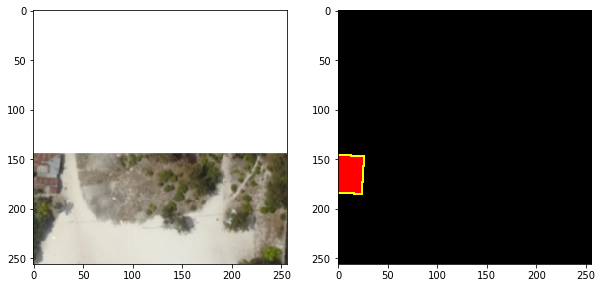

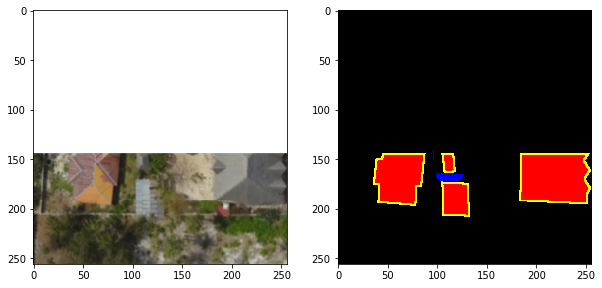




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 bd5c14
 iteration 4
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

1it [00:00,  5.01it/s]

2it [00:00,  4.98it/s]

3it [00:00,  4.89it/s]

4it [00:00,  5.39it/s]

5it [00:00,  5.15it/s]

6it [00:01,  4.90it/s]

7it [00:01,  4.71it/s]

8it [00:01,  5.52it/s]

9it [00:01,  6.36it/s]

10it [00:01,  7.10it/s]

11it [00:01,  6.78it/s]

12it [00:02,  6.65it/s]

13it [00:02,  6.23it/s]

14it [00:02,  6.01it/s]

15it [00:02,  6.75it/s]

16it [00:02,  6.60it/s]

17it [00:02,  6.07it/s]

18it [00:03,  6.34it/s]

19it [00:03,  6.20it/s]

20it [00:03,  6.84it/s]

21it [00:03,  6.91it/s]

22it [00:03,  7.23it/s]

23it [00:03,  7.53it/s]

24it [00:03,  7.21it/s]

25it [00:03,  7.43it/s]

26it [00:04,  7.95it/s]

27it [00:04,  8.43it/s]

28it [00:04,  8.70it/s]

29it [00:04,  8.88it/s]

30it [00:04,  8.07it/s]

31it [00:04,  7.53it/s]

32it [00:04,  7.60it/s]

33it [00:04,  7.42it/s]

34it [00:05,  7.88it/s]

35it [00:05,  8.05it/s]

36it [00:05,  8.48it/s]

37it [00:05,  8.74it/s]

38it [00:05,  8.93it/s]

40it [00:05,  9.37it/s]

41it [00:05,

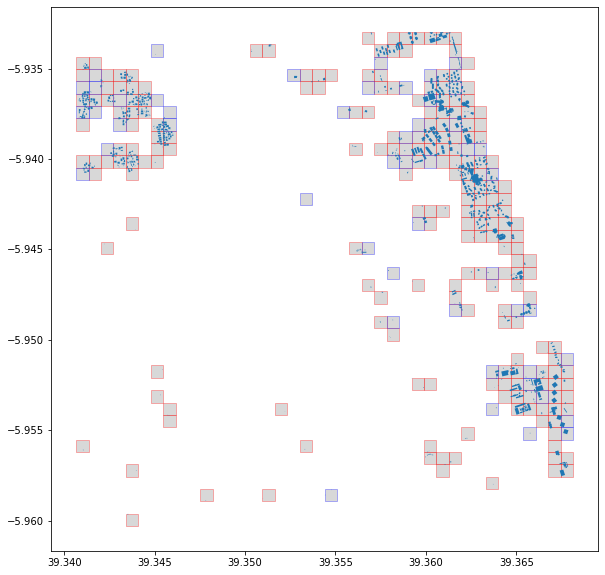

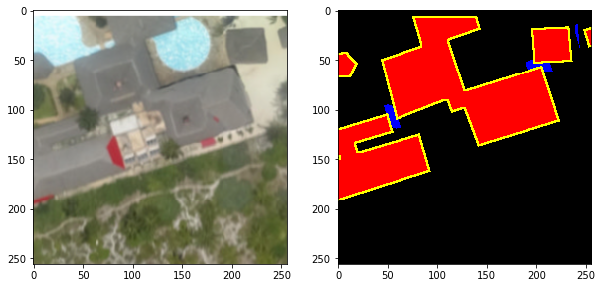

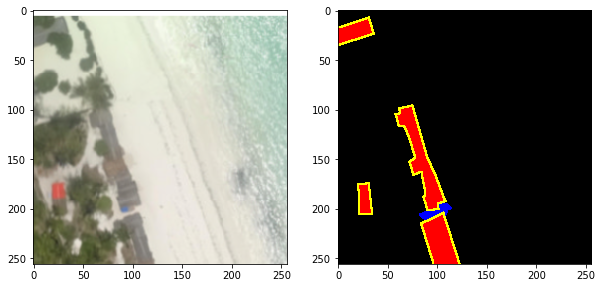

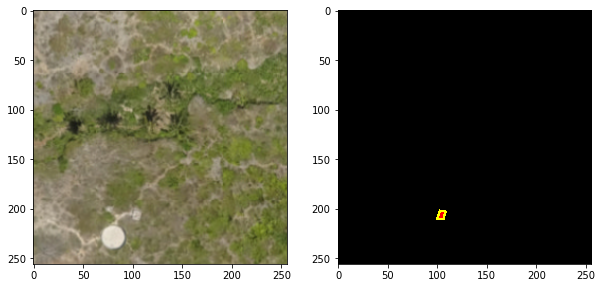

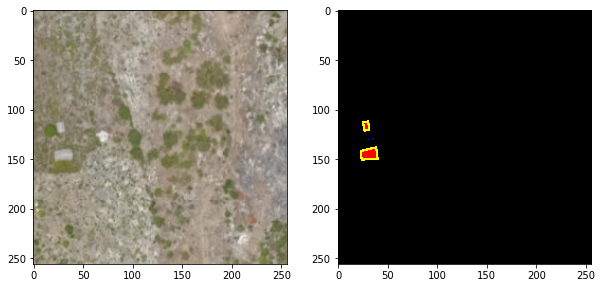

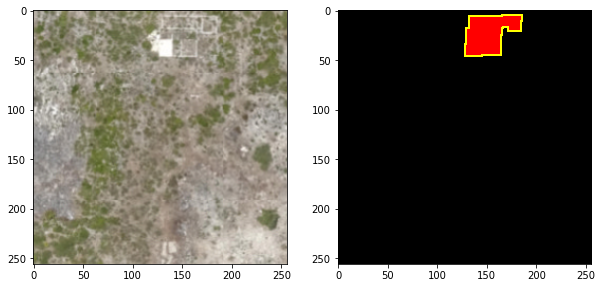




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 75cdfa
 iteration 5
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

1it [00:00,  8.83it/s]

2it [00:00,  8.20it/s]

4it [00:00,  9.63it/s]

5it [00:00,  9.27it/s]

6it [00:00,  8.57it/s]

7it [00:00,  8.36it/s]

8it [00:00,  7.89it/s]

9it [00:01,  7.55it/s]

10it [00:01,  6.84it/s]

11it [00:01,  6.71it/s]

12it [00:01,  6.45it/s]

13it [00:01,  6.39it/s]

14it [00:01,  6.62it/s]

15it [00:02,  6.61it/s]

16it [00:02,  6.90it/s]

17it [00:02,  7.54it/s]

18it [00:02,  7.23it/s]

19it [00:02,  7.22it/s]

20it [00:02,  7.06it/s]

21it [00:02,  7.64it/s]

22it [00:02,  7.79it/s]

23it [00:03,  7.85it/s]

24it [00:03,  7.71it/s]

25it [00:03,  7.79it/s]

26it [00:03,  7.51it/s]

27it [00:03,  7.59it/s]

28it [00:03,  7.83it/s]

29it [00:03,  8.08it/s]

30it [00:03,  8.07it/s]

31it [00:04,  8.28it/s]

32it [00:04,  8.44it/s]

33it [00:04,  8.07it/s]

34it [00:04,  8.00it/s]

35it [00:04,  8.07it/s]

36it [00:04,  8.10it/s]

37it [00:04,  8.02it/s]

38it [00:04,  8.21it/s]

39it [00:05,  8.21it/s]

40it [00:05,  8.30it/s]

41it [00:05

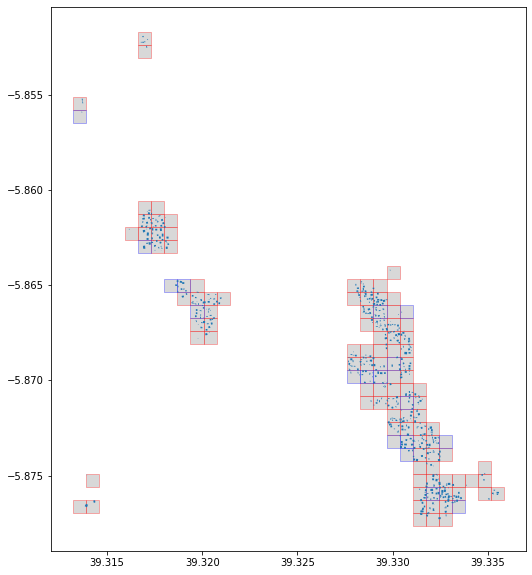

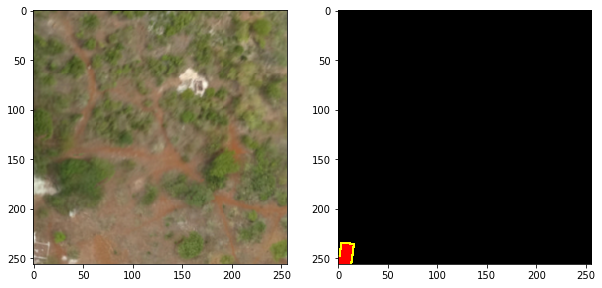

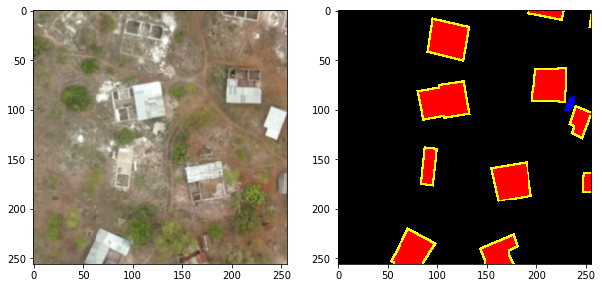

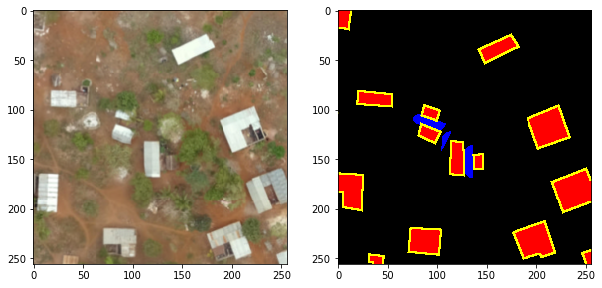

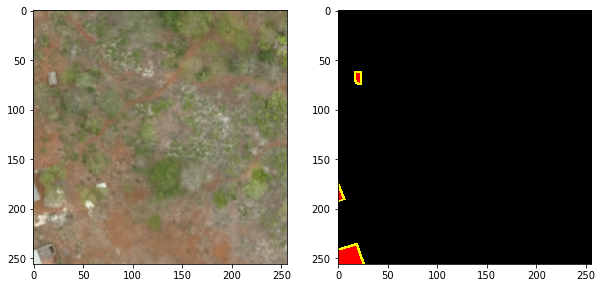

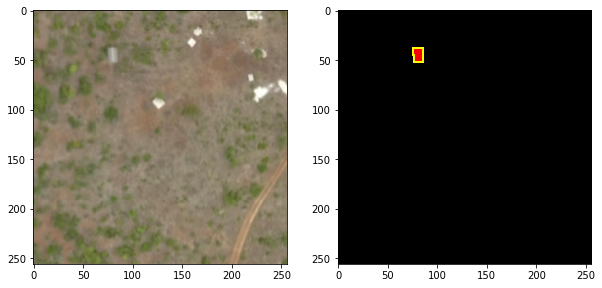




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 425403
 iteration 6
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

1it [00:00,  6.63it/s]

2it [00:00,  7.36it/s]

4it [00:00,  8.18it/s]

6it [00:00,  7.93it/s]

7it [00:00,  8.04it/s]

9it [00:01,  8.50it/s]

10it [00:01,  8.32it/s]

11it [00:01,  8.74it/s]

13it [00:01,  9.47it/s]

14it [00:01,  9.57it/s]

16it [00:01,  9.98it/s]

18it [00:01, 10.12it/s]

20it [00:02, 10.58it/s]

22it [00:02, 10.25it/s]

24it [00:02,  7.90it/s]

25it [00:02,  7.76it/s]

26it [00:02,  7.94it/s]

27it [00:03,  8.33it/s]

28it [00:03,  6.55it/s]

29it [00:03,  7.23it/s]

30it [00:03,  5.78it/s]

32it [00:03,  6.71it/s]

33it [00:03,  7.08it/s]

34it [00:04,  7.63it/s]

35it [00:04,  8.05it/s]

37it [00:04,  8.10it/s]

38it [00:04,  8.58it/s]

39it [00:04,  8.74it/s]

40it [00:04,  8.00it/s]

41it [00:04,  8.25it/s]

42it [00:04,  8.30it/s]

43it [00:05,  8.43it/s]

44it [00:05,  6.64it/s]

45it [00:05,  6.59it/s]

46it [00:05,  7.18it/s]

48it [00:05,  7.41it/s]

49it [00:05,  7.70it/s]

50it [00:06,  7.50it/s]

51it [00:06,  7.75it/s]

52it [00:

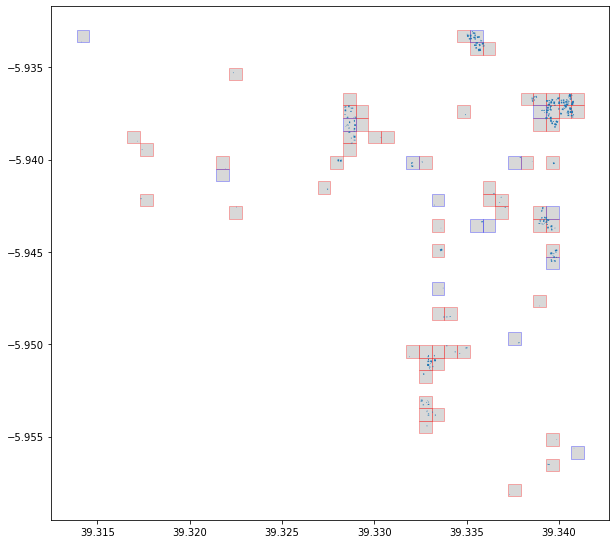

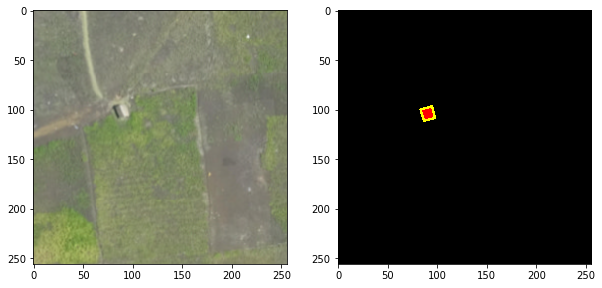

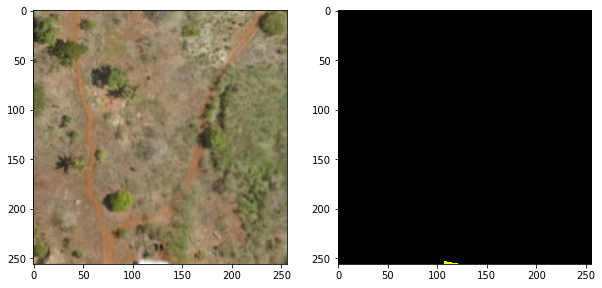

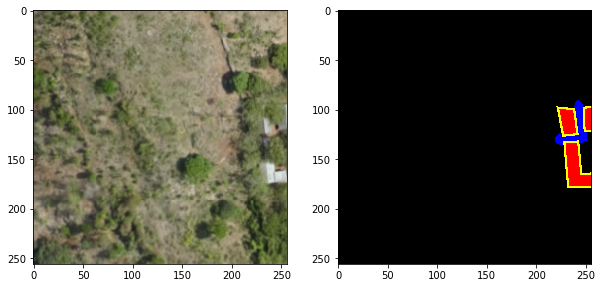

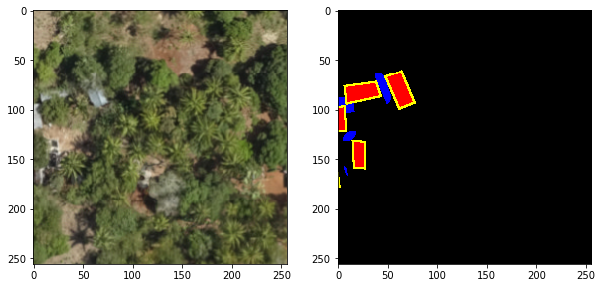

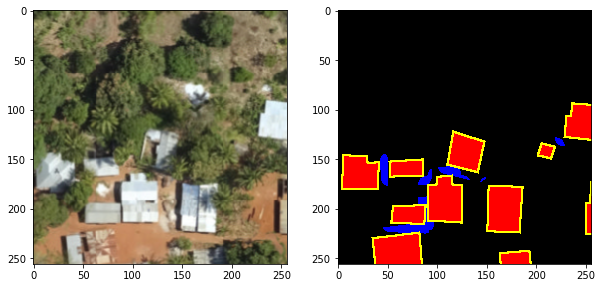




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 e52478
 iteration 7
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

1it [00:00,  6.40it/s]

2it [00:00,  7.08it/s]

3it [00:00,  6.96it/s]

5it [00:00,  8.39it/s]

7it [00:00,  9.42it/s]

8it [00:00,  9.21it/s]

10it [00:00, 10.22it/s]

12it [00:01, 10.16it/s]

14it [00:01,  9.70it/s]

15it [00:01,  9.66it/s]

17it [00:01,  9.77it/s]



0it [00:00, ?it/s]

1it [00:00,  3.90it/s]

2it [00:00,  3.77it/s]

3it [00:00,  3.79it/s]

4it [00:01,  3.69it/s]

5it [00:01,  3.70it/s]

6it [00:01,  3.55it/s]

7it [00:01,  3.62it/s]

8it [00:02,  3.72it/s]

9it [00:02,  3.71it/s]

10it [00:02,  3.69it/s]

11it [00:02,  3.74it/s]

12it [00:03,  3.66it/s]

13it [00:03,  3.63it/s]

14it [00:03,  3.63it/s]

15it [00:04,  3.70it/s]

16it [00:04,  3.76it/s]

17it [00:04,  3.78it/s]



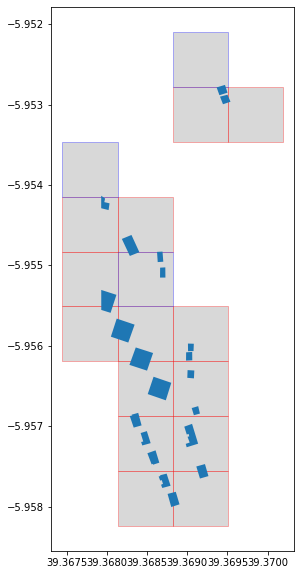

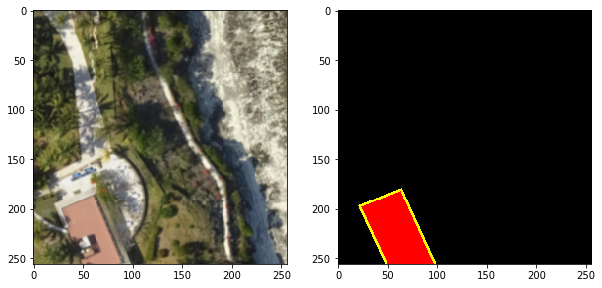

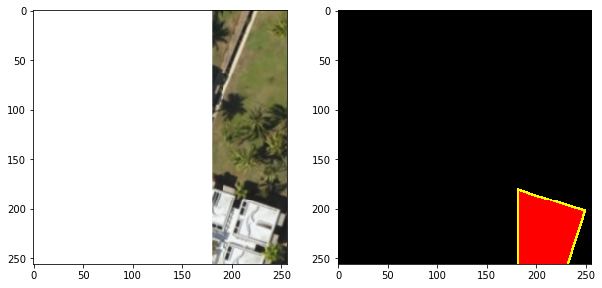

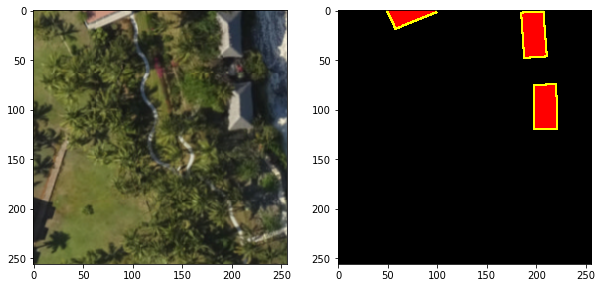

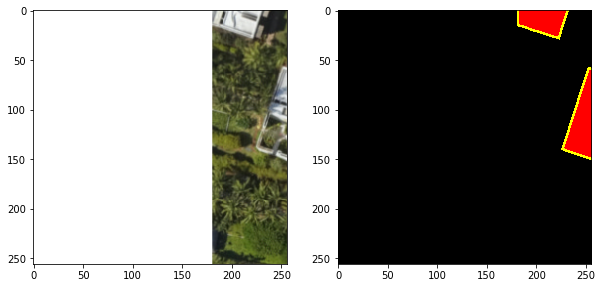

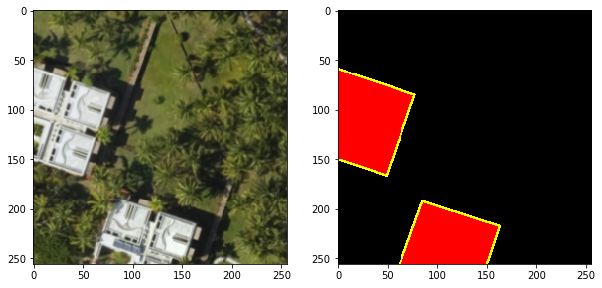




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 3f8360
 iteration 8
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

1it [00:00,  6.64it/s]

2it [00:00,  6.73it/s]

3it [00:00,  7.44it/s]

5it [00:00,  8.19it/s]

6it [00:00,  8.12it/s]

8it [00:00,  8.66it/s]

9it [00:01,  8.64it/s]

10it [00:01,  6.41it/s]

11it [00:01,  6.94it/s]

12it [00:01,  7.29it/s]

13it [00:01,  7.78it/s]

14it [00:01,  7.81it/s]

15it [00:01,  8.05it/s]

16it [00:01,  8.24it/s]

17it [00:02,  8.61it/s]

19it [00:02,  9.26it/s]

20it [00:02,  9.03it/s]

21it [00:02,  9.04it/s]

22it [00:02,  9.22it/s]

23it [00:02,  8.97it/s]

25it [00:02,  9.54it/s]

27it [00:03,  9.90it/s]

29it [00:03,  9.86it/s]

30it [00:03,  8.89it/s]

31it [00:03,  8.65it/s]

32it [00:03,  8.56it/s]

33it [00:03,  8.57it/s]

34it [00:03,  8.45it/s]

35it [00:04,  6.74it/s]

36it [00:04,  7.47it/s]

38it [00:04,  8.32it/s]

39it [00:04,  8.56it/s]

40it [00:04,  8.92it/s]

41it [00:04,  8.97it/s]

42it [00:04,  8.55it/s]

43it [00:04,  8.06it/s]

44it [00:05,  7.85it/s]

45it [00:05,  8.32it/s]

46it [00:05,  8.16it/s]

48it [00:0

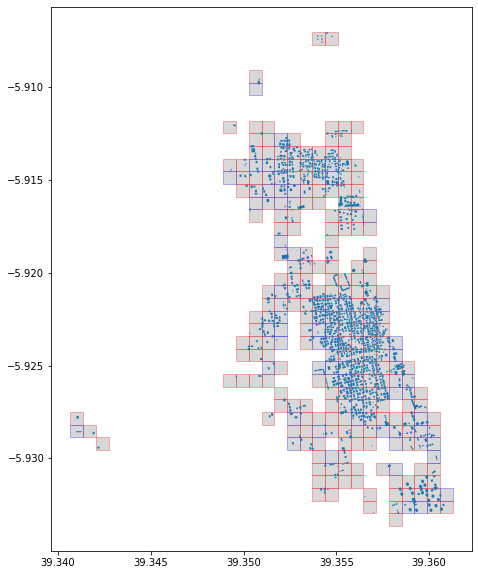

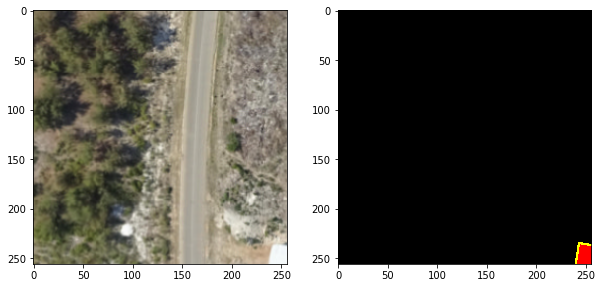

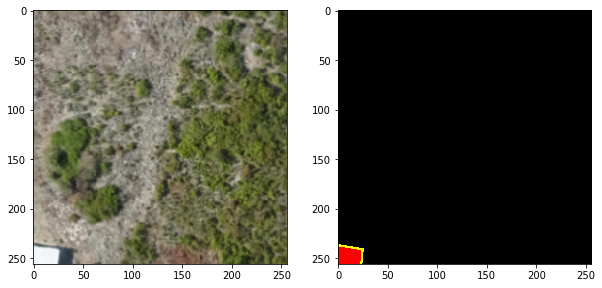

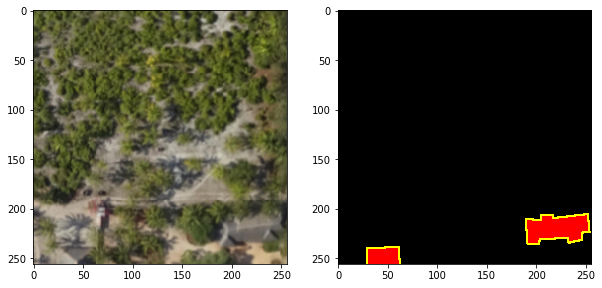

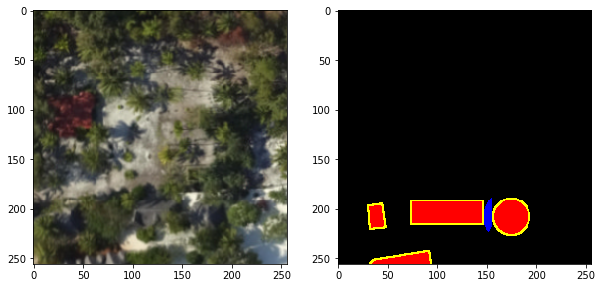

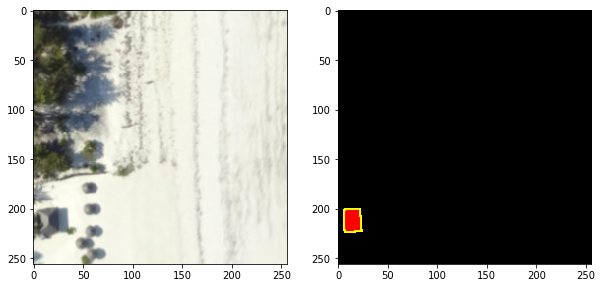




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 9b8638
 iteration 9
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

3it [00:00, 20.89it/s]

5it [00:00, 16.32it/s]

6it [00:00, 13.61it/s]

8it [00:01,  6.04it/s]

9it [00:01,  5.70it/s]

10it [00:01,  5.71it/s]

11it [00:01,  5.56it/s]

13it [00:01,  6.50it/s]

14it [00:02,  7.07it/s]

15it [00:02,  7.31it/s]

16it [00:02,  7.39it/s]

17it [00:02,  6.95it/s]

18it [00:02,  7.63it/s]

19it [00:02,  7.97it/s]

20it [00:02,  8.17it/s]

21it [00:02,  8.15it/s]

22it [00:03,  7.60it/s]

23it [00:03,  6.54it/s]

25it [00:03,  7.29it/s]

26it [00:03,  7.27it/s]

27it [00:03,  7.40it/s]

28it [00:03,  7.25it/s]

29it [00:04,  6.60it/s]

30it [00:04,  7.35it/s]

31it [00:04,  7.83it/s]

32it [00:04,  8.17it/s]

33it [00:04,  8.23it/s]

34it [00:04,  8.16it/s]

35it [00:04,  7.94it/s]

36it [00:04,  6.57it/s]

37it [00:05,  6.98it/s]

38it [00:05,  7.52it/s]

39it [00:05,  7.82it/s]

40it [00:05,  7.58it/s]

41it [00:05,  7.53it/s]

42it [00:05,  7.16it/s]

43it [00:05,  6.13it/s]

44it [00:06,  6.82it/s]

45it [00:06,  7.44it/s]

46it [00

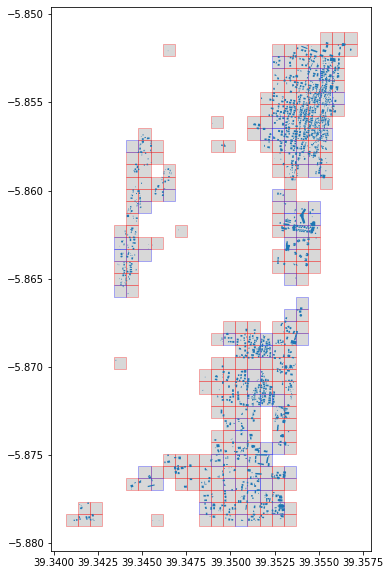

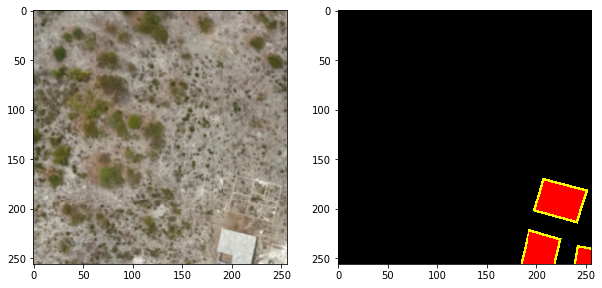

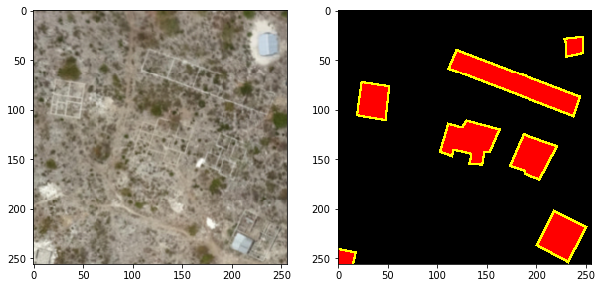

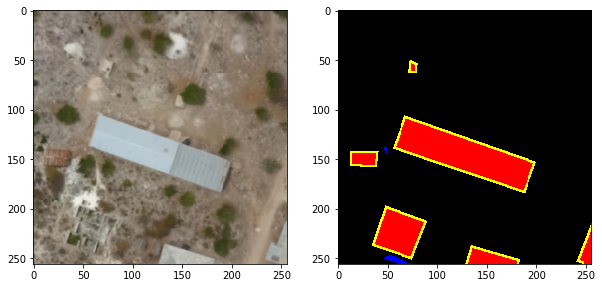

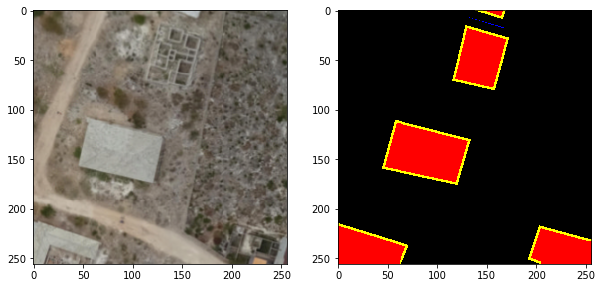

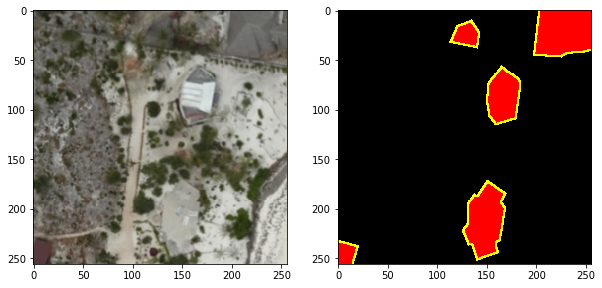




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 06f252
 iteration 10
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

2it [00:00, 13.92it/s]

4it [00:00, 13.77it/s]

6it [00:00, 12.50it/s]

7it [00:00, 10.48it/s]

8it [00:00,  9.45it/s]

9it [00:00,  9.39it/s]

10it [00:00,  9.34it/s]

11it [00:01,  8.94it/s]

12it [00:01,  8.50it/s]

13it [00:01,  8.38it/s]

14it [00:01,  8.18it/s]

15it [00:01,  8.25it/s]

16it [00:01,  8.48it/s]

17it [00:01,  8.52it/s]

18it [00:01,  8.18it/s]

19it [00:02,  8.13it/s]

20it [00:02,  8.18it/s]

21it [00:02,  8.32it/s]

22it [00:02,  8.26it/s]

23it [00:02,  8.12it/s]

24it [00:02,  7.95it/s]

25it [00:02,  7.86it/s]

26it [00:02,  7.80it/s]

27it [00:03,  7.88it/s]

28it [00:03,  8.01it/s]

29it [00:03,  8.29it/s]

30it [00:03,  8.57it/s]

31it [00:03,  8.58it/s]

32it [00:03,  8.49it/s]

33it [00:03,  8.34it/s]

34it [00:03,  8.50it/s]

35it [00:04,  8.46it/s]

36it [00:04,  8.06it/s]

37it [00:04,  7.96it/s]

38it [00:04,  8.10it/s]

39it [00:04,  8.35it/s]

40it [00:04,  8.38it/s]

41it [00:04,  8.68it/s]

42it [00:04,  8.50it/s]

43it [00:

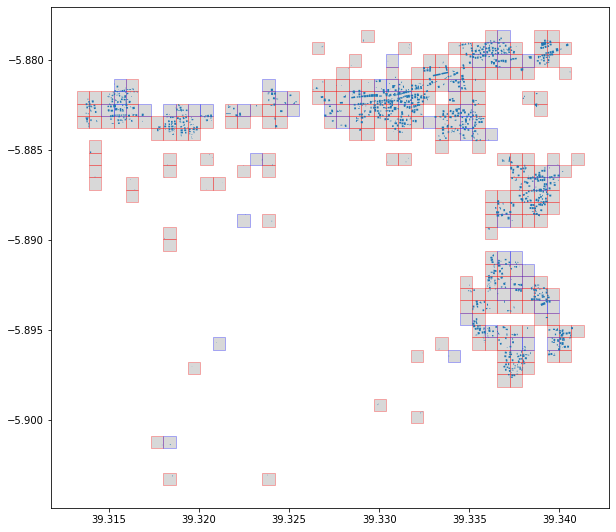

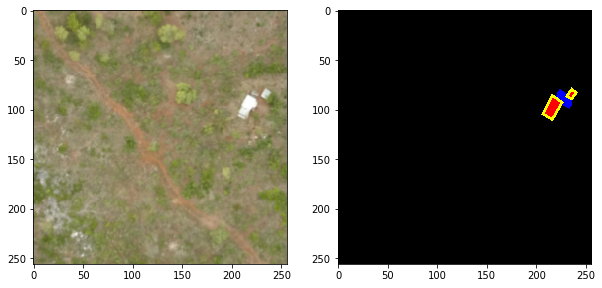

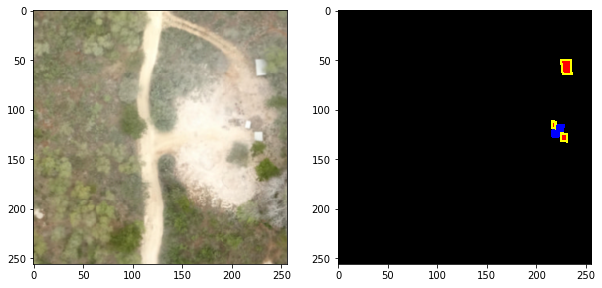

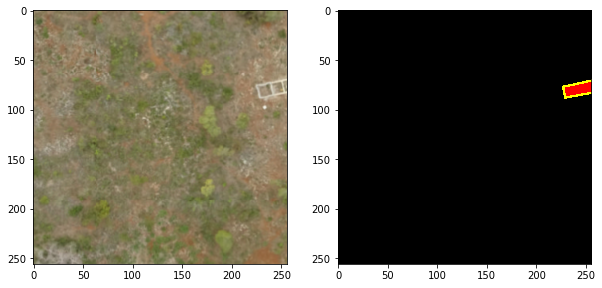

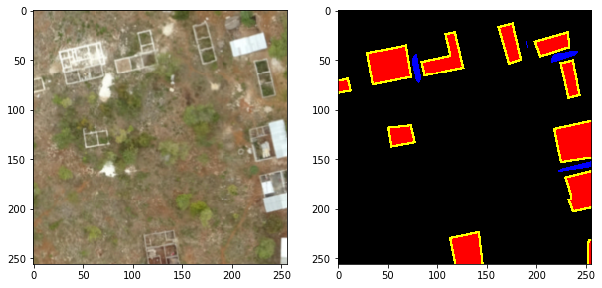

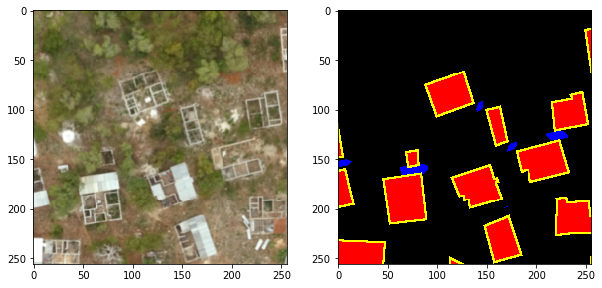




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 aee7fd
 iteration 11
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

1it [00:00,  9.98it/s]

3it [00:00, 10.13it/s]

4it [00:00,  9.80it/s]

5it [00:00,  9.16it/s]

6it [00:00,  9.02it/s]

7it [00:00,  9.11it/s]

8it [00:00,  8.92it/s]

9it [00:00,  9.04it/s]

10it [00:01,  8.24it/s]

12it [00:01,  9.59it/s]

14it [00:01,  8.75it/s]

16it [00:01,  9.59it/s]

18it [00:01,  9.33it/s]

19it [00:02,  9.19it/s]

20it [00:02,  9.10it/s]

21it [00:02,  9.06it/s]

22it [00:02,  8.96it/s]

23it [00:02,  8.60it/s]

24it [00:02,  8.22it/s]

25it [00:02,  8.04it/s]

26it [00:02,  7.94it/s]

27it [00:03,  8.18it/s]

28it [00:03,  8.27it/s]

29it [00:03,  8.18it/s]

30it [00:03,  8.31it/s]

31it [00:03,  7.85it/s]

32it [00:03,  7.60it/s]

33it [00:03,  7.62it/s]

34it [00:03,  7.77it/s]

35it [00:04,  7.67it/s]

36it [00:04,  7.37it/s]

37it [00:04,  7.55it/s]

38it [00:04,  6.56it/s]

39it [00:04,  6.96it/s]

40it [00:04,  7.25it/s]

41it [00:04,  6.74it/s]

42it [00:05,  6.92it/s]

43it [00:05,  6.97it/s]

44it [00:05,  6.74it/s]

45it [00:05

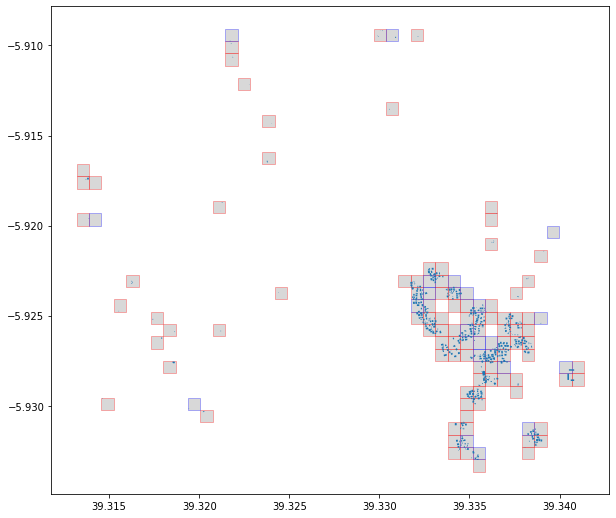

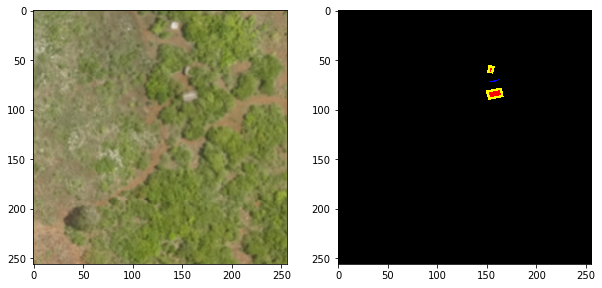

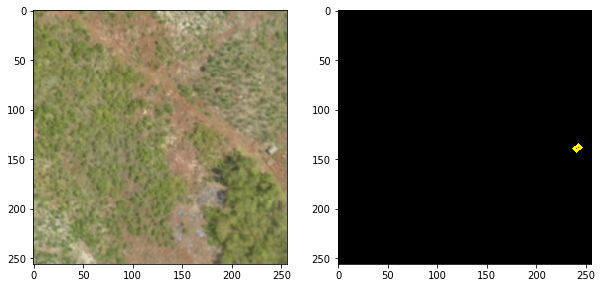

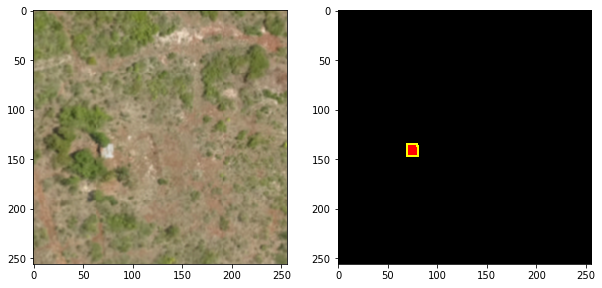

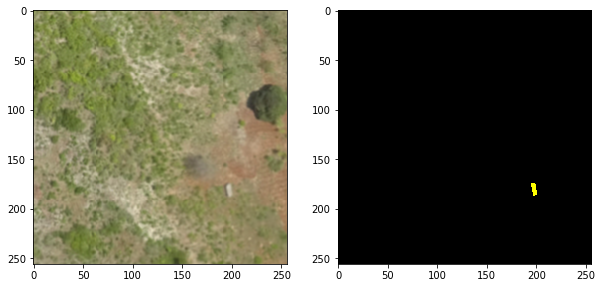

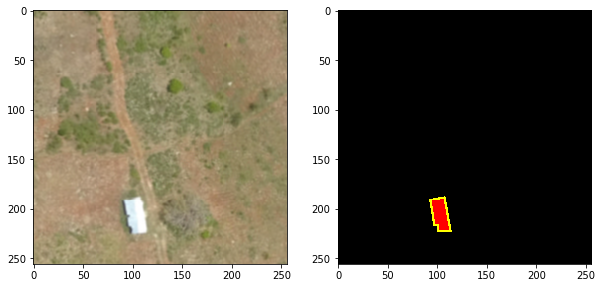




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 bc32f1
 iteration 12
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

2it [00:00, 14.93it/s]

4it [00:00, 13.32it/s]

5it [00:00, 11.51it/s]

7it [00:00, 10.95it/s]

9it [00:00, 10.95it/s]

10it [00:00, 10.45it/s]

11it [00:01,  9.72it/s]

12it [00:01,  9.77it/s]

13it [00:01,  9.56it/s]

15it [00:01, 10.08it/s]

17it [00:01, 10.17it/s]

19it [00:01,  9.94it/s]

21it [00:02,  9.98it/s]

22it [00:02,  9.52it/s]

24it [00:02,  9.59it/s]

25it [00:02,  9.51it/s]

26it [00:02,  8.15it/s]

27it [00:02,  8.57it/s]

28it [00:02,  8.83it/s]

29it [00:02,  8.88it/s]

30it [00:03,  8.96it/s]

31it [00:03,  8.81it/s]

33it [00:03,  9.38it/s]

34it [00:03,  7.43it/s]

35it [00:03,  7.23it/s]

36it [00:03,  7.59it/s]

37it [00:03,  7.98it/s]

38it [00:04,  8.43it/s]

39it [00:04,  8.14it/s]

40it [00:04,  7.87it/s]

41it [00:04,  8.26it/s]

42it [00:04,  7.07it/s]

43it [00:04,  6.58it/s]

44it [00:04,  6.84it/s]

45it [00:05,  7.04it/s]

46it [00:05,  6.93it/s]

47it [00:05,  6.27it/s]

48it [00:05,  6.28it/s]

49it [00:05,  6.50it/s]

50it [00

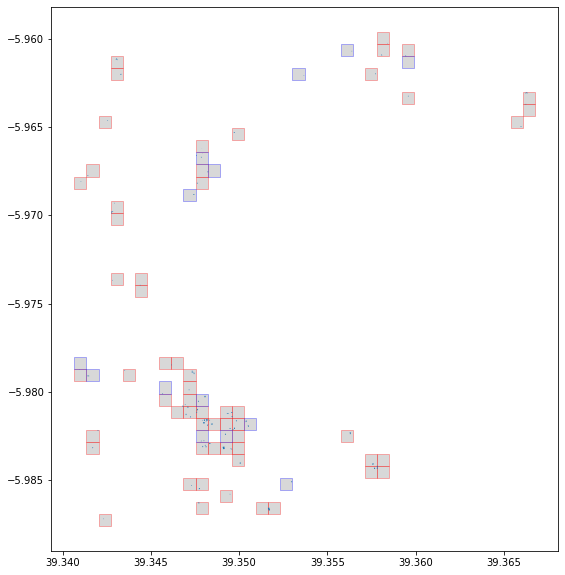

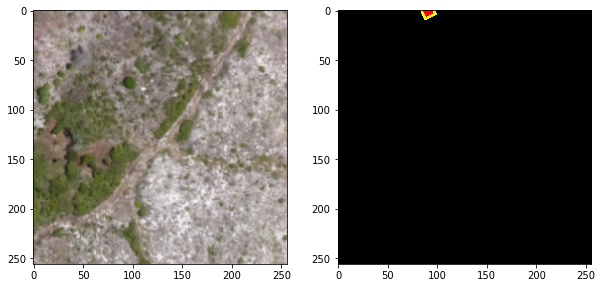

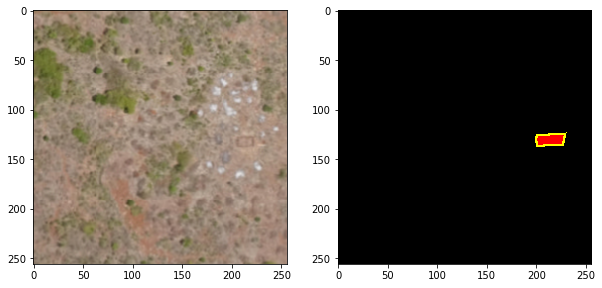

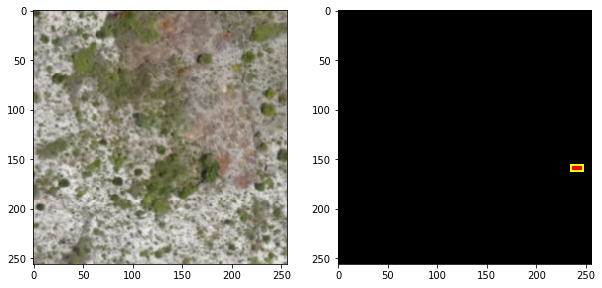

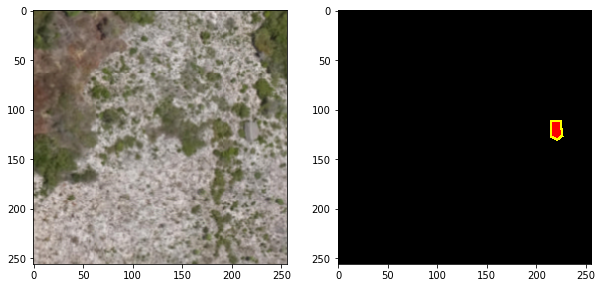

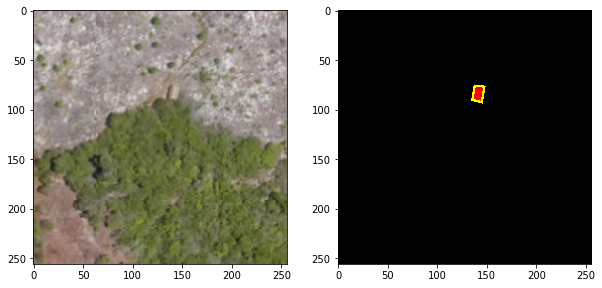




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 33cae6
 iteration 13
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

1it [00:00,  3.37it/s]

2it [00:00,  3.71it/s]

3it [00:00,  3.40it/s]

4it [00:01,  3.41it/s]

5it [00:01,  3.26it/s]

6it [00:01,  3.41it/s]

7it [00:01,  3.62it/s]

8it [00:02,  3.86it/s]

9it [00:02,  4.29it/s]

10it [00:02,  4.83it/s]

11it [00:02,  4.87it/s]

12it [00:02,  4.86it/s]

13it [00:03,  5.00it/s]

14it [00:03,  4.78it/s]

15it [00:03,  3.89it/s]

16it [00:03,  3.79it/s]

17it [00:04,  4.13it/s]

18it [00:04,  4.34it/s]

19it [00:04,  4.46it/s]

20it [00:04,  4.78it/s]

21it [00:04,  5.23it/s]

22it [00:05,  5.54it/s]

23it [00:05,  5.86it/s]

24it [00:05,  6.33it/s]

25it [00:05,  6.64it/s]

26it [00:05,  6.80it/s]

27it [00:05,  6.78it/s]

28it [00:05,  6.75it/s]

29it [00:06,  6.71it/s]

30it [00:06,  6.89it/s]

31it [00:06,  6.92it/s]

32it [00:06,  6.53it/s]

33it [00:06,  5.83it/s]

34it [00:06,  5.60it/s]

35it [00:07,  5.88it/s]

36it [00:07,  5.93it/s]

37it [00:07,  6.11it/s]

38it [00:07,  6.30it/s]

39it [00:07,  6.37it/s]

40it [00:07,

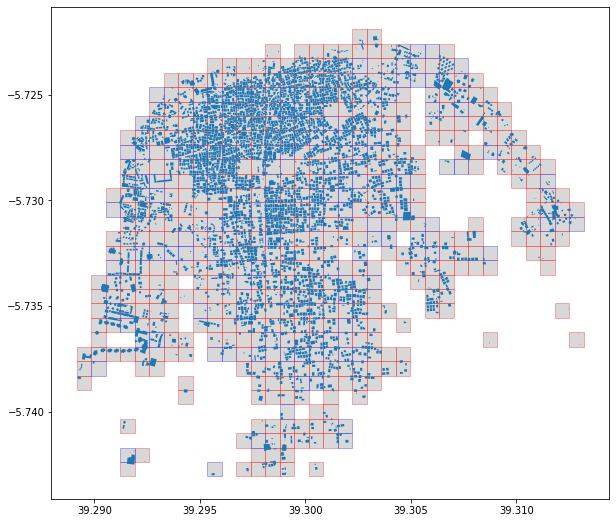

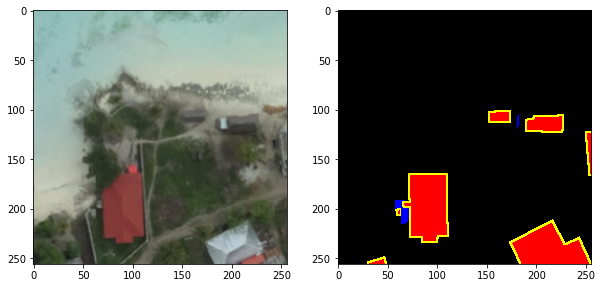

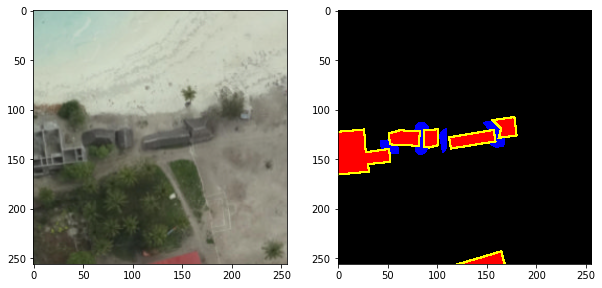

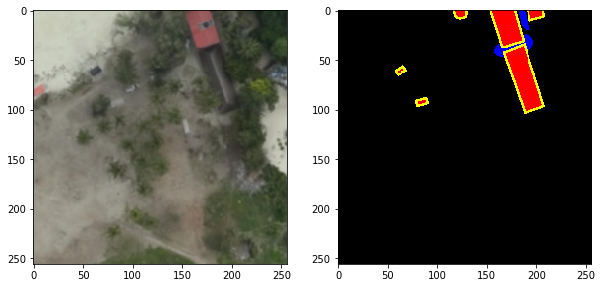

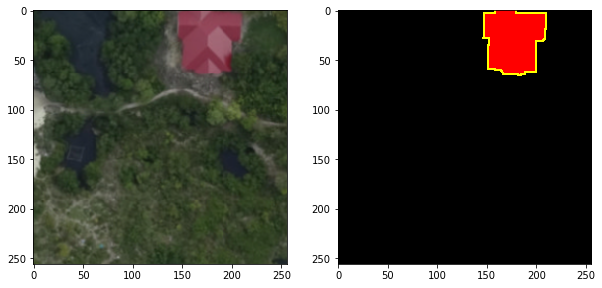

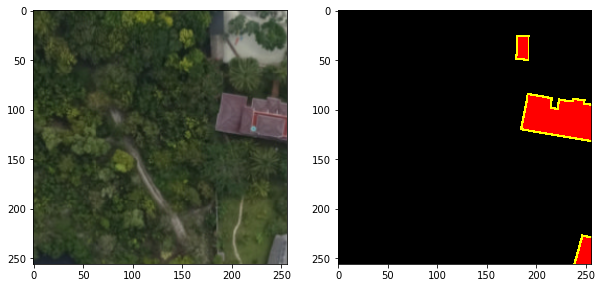




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 znz
 3b20d4
 iteration 14
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

2it [00:00,  7.60it/s]

3it [00:00,  7.44it/s]

4it [00:00,  7.89it/s]

5it [00:00,  8.13it/s]

7it [00:00,  8.45it/s]

8it [00:00,  8.51it/s]

9it [00:01,  8.68it/s]

10it [00:01,  8.77it/s]

11it [00:01,  8.44it/s]

12it [00:01,  8.31it/s]

13it [00:01,  7.96it/s]

15it [00:01,  7.82it/s]

16it [00:01,  7.60it/s]

18it [00:02,  8.42it/s]

19it [00:02,  7.99it/s]

20it [00:02,  7.85it/s]

22it [00:02,  8.63it/s]

23it [00:02,  8.40it/s]

24it [00:02,  8.18it/s]

25it [00:02,  8.07it/s]

26it [00:03,  6.80it/s]

27it [00:03,  6.84it/s]

28it [00:03,  7.45it/s]

29it [00:03,  7.86it/s]

30it [00:03,  5.52it/s]

31it [00:03,  6.22it/s]

32it [00:04,  6.65it/s]

33it [00:04,  7.11it/s]

35it [00:04,  7.61it/s]

36it [00:04,  7.83it/s]

37it [00:04,  8.07it/s]

38it [00:04,  8.31it/s]

40it [00:04,  8.87it/s]

41it [00:05,  9.11it/s]

42it [00:05,  9.14it/s]

43it [00:05,  8.75it/s]

44it [00:05,  8.33it/s]

46it [00:05,  8.93it/s]

47it [00:05,  8.86it/s]

49it [00:0

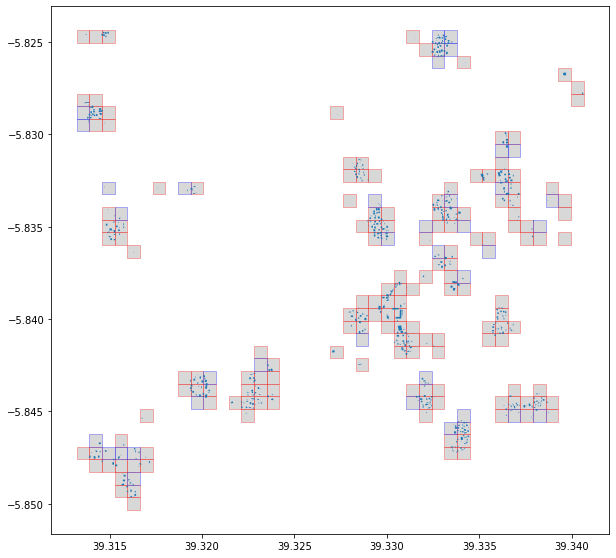

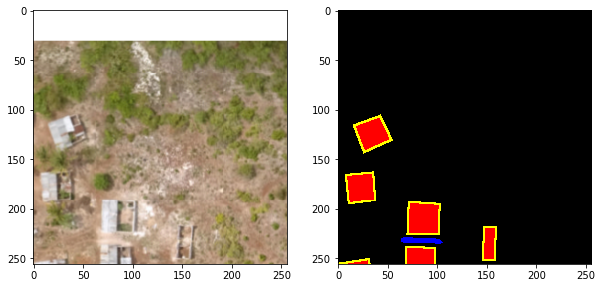

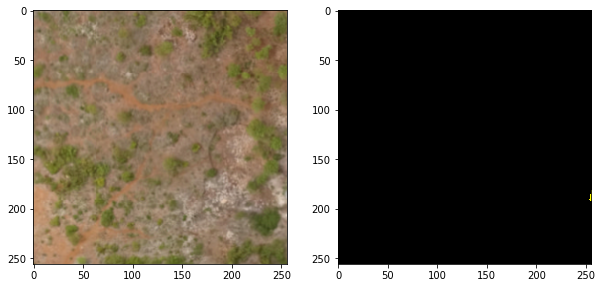

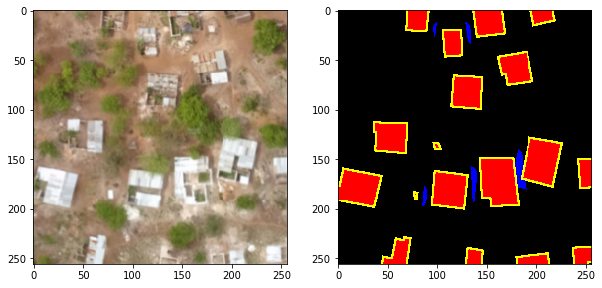

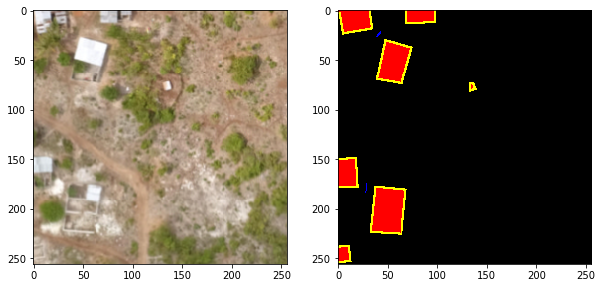

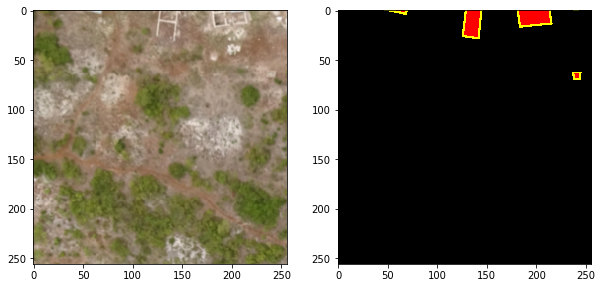




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 kam
 4e7c7f
 iteration 15
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

2it [00:00, 11.38it/s]

4it [00:00,  9.78it/s]

5it [00:00,  9.27it/s]

6it [00:00,  8.81it/s]

7it [00:00,  7.99it/s]

8it [00:01,  6.99it/s]

10it [00:01,  7.53it/s]

11it [00:01,  7.23it/s]

12it [00:01,  7.09it/s]

13it [00:01,  7.08it/s]

14it [00:01,  6.48it/s]

16it [00:02,  7.41it/s]

17it [00:02,  7.36it/s]

18it [00:02,  7.39it/s]

19it [00:02,  7.12it/s]

20it [00:02,  7.20it/s]

21it [00:02,  7.33it/s]

23it [00:02,  7.65it/s]

24it [00:03,  7.69it/s]

25it [00:03,  7.71it/s]

26it [00:03,  7.73it/s]

27it [00:03,  7.91it/s]

28it [00:03,  7.92it/s]

29it [00:03,  7.98it/s]

30it [00:03,  7.13it/s]

32it [00:04,  8.30it/s]

34it [00:04,  9.27it/s]

36it [00:04,  8.58it/s]

37it [00:04,  8.39it/s]

38it [00:04,  8.57it/s]

39it [00:04,  8.43it/s]

40it [00:04,  8.67it/s]

41it [00:05,  8.40it/s]

42it [00:05,  7.90it/s]

43it [00:05,  6.93it/s]

44it [00:05,  7.05it/s]

46it [00:05,  7.94it/s]

47it [00:05,  7.70it/s]

48it [00:05,  7.87it/s]

49it [00:

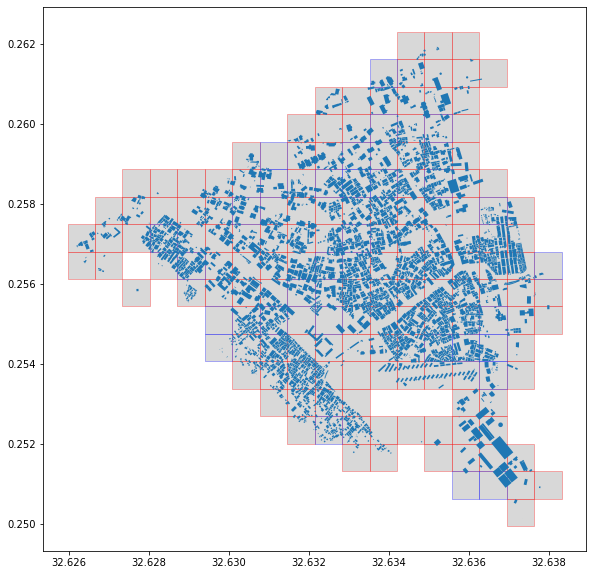

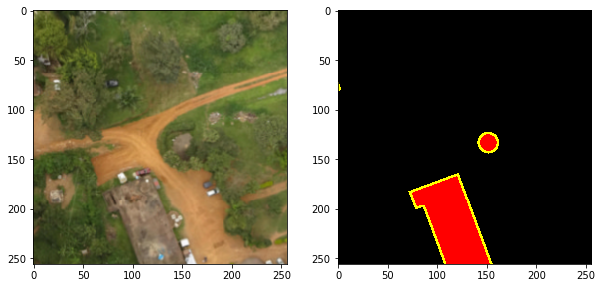

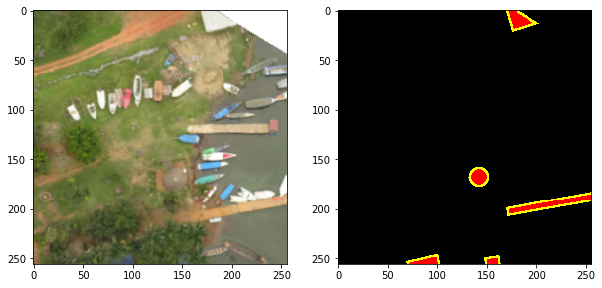

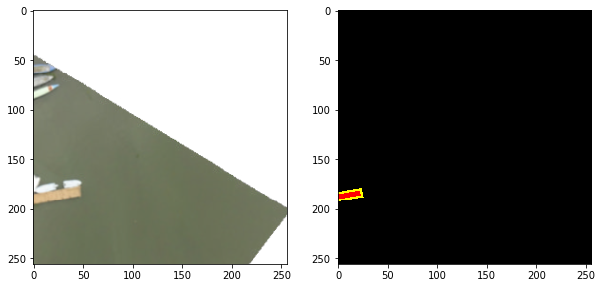

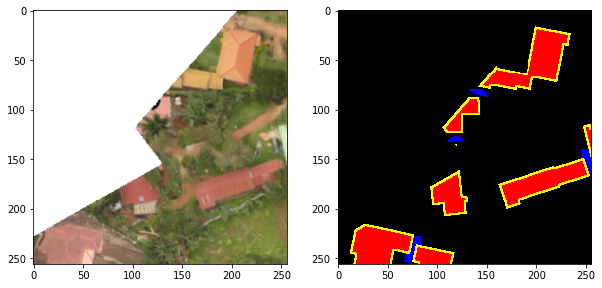

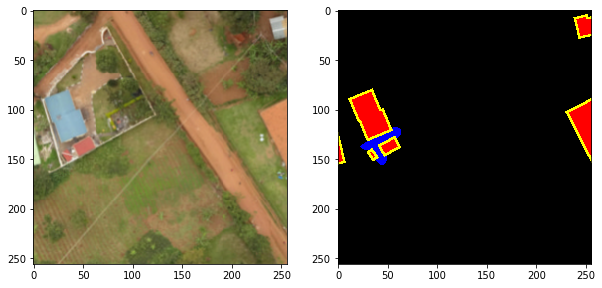




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 mon
 401175
 iteration 16
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

2it [00:00, 10.85it/s]

3it [00:00,  8.06it/s]

4it [00:00,  6.18it/s]

5it [00:00,  5.98it/s]

7it [00:00,  7.31it/s]

8it [00:01,  6.83it/s]

9it [00:01,  5.93it/s]

10it [00:01,  4.97it/s]

11it [00:01,  4.52it/s]

12it [00:02,  4.31it/s]

13it [00:02,  4.23it/s]

14it [00:02,  4.36it/s]

15it [00:02,  4.20it/s]

16it [00:03,  4.30it/s]

18it [00:03,  4.90it/s]

19it [00:03,  4.54it/s]

20it [00:03,  4.11it/s]

21it [00:04,  4.26it/s]

22it [00:04,  4.53it/s]

23it [00:04,  4.46it/s]

24it [00:04,  4.79it/s]

25it [00:04,  4.49it/s]

26it [00:05,  4.44it/s]

27it [00:05,  4.65it/s]

28it [00:05,  4.88it/s]

30it [00:05,  6.05it/s]

31it [00:05,  5.55it/s]

32it [00:06,  5.70it/s]

33it [00:06,  5.35it/s]

34it [00:06,  5.05it/s]

35it [00:06,  5.02it/s]

36it [00:06,  5.10it/s]

37it [00:07,  5.03it/s]

38it [00:07,  5.04it/s]

39it [00:07,  5.22it/s]

40it [00:07,  5.35it/s]

41it [00:07,  5.04it/s]

42it [00:08,  5.41it/s]

43it [00:08,  5.72it/s]

44it [00:0

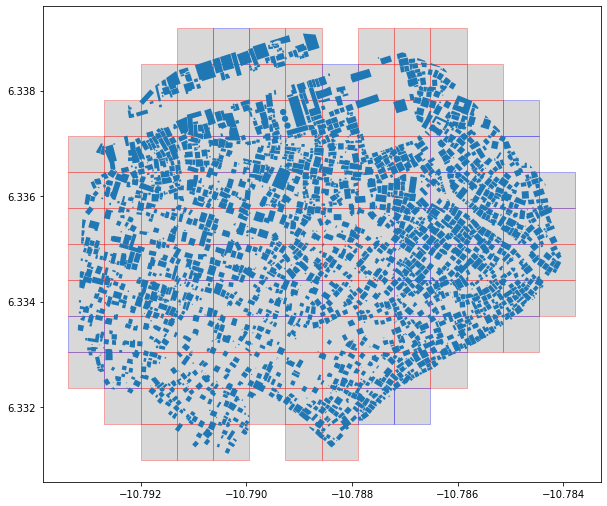

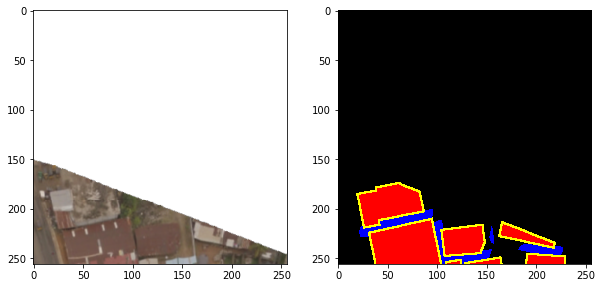

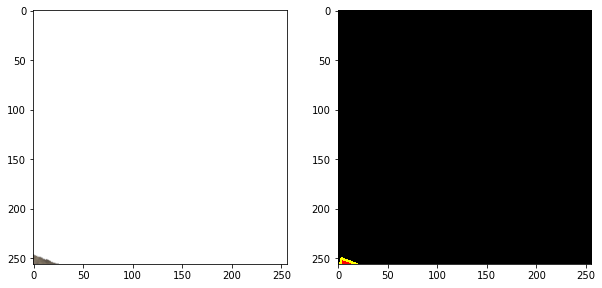

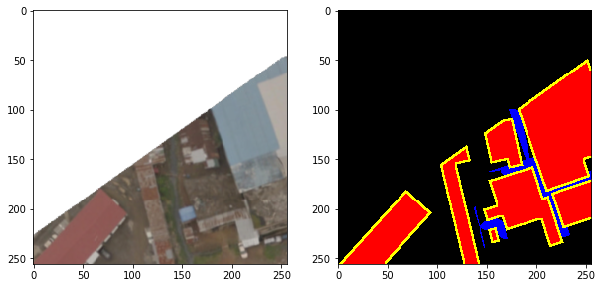

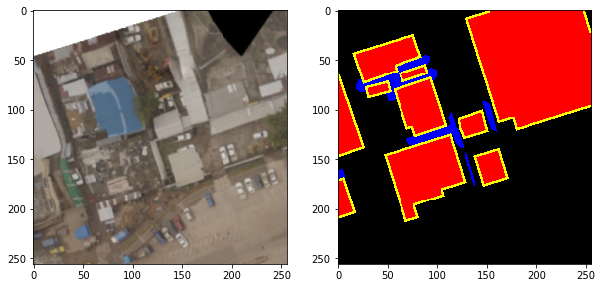

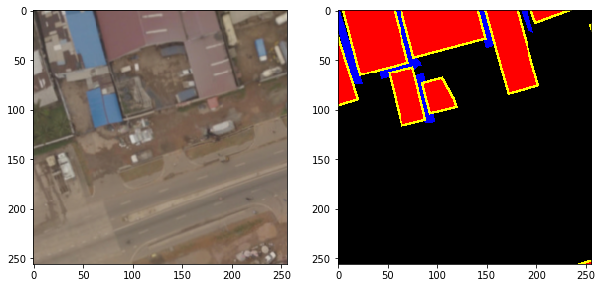




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 mon
 207cc7
 iteration 17
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

2it [00:00, 16.18it/s]

3it [00:00, 10.91it/s]

4it [00:00,  8.39it/s]

6it [00:00,  8.82it/s]

7it [00:00,  7.86it/s]

8it [00:00,  7.46it/s]

9it [00:01,  6.80it/s]

10it [00:01,  6.83it/s]

12it [00:01,  7.82it/s]

14it [00:01,  8.59it/s]

15it [00:01,  7.93it/s]

16it [00:01,  7.61it/s]

17it [00:02,  7.49it/s]

18it [00:02,  7.37it/s]

19it [00:02,  7.31it/s]

20it [00:02,  7.10it/s]

21it [00:02,  7.61it/s]

23it [00:02,  7.69it/s]

24it [00:03,  7.09it/s]

27it [00:03,  8.56it/s]

29it [00:03,  8.18it/s]

30it [00:03,  7.69it/s]

31it [00:03,  7.38it/s]

32it [00:03,  7.25it/s]

33it [00:04,  7.32it/s]

34it [00:04,  7.21it/s]

35it [00:04,  7.27it/s]

36it [00:04,  6.53it/s]

37it [00:04,  5.93it/s]

38it [00:04,  6.12it/s]

39it [00:05,  6.32it/s]

40it [00:05,  6.16it/s]

41it [00:05,  6.57it/s]

42it [00:05,  6.61it/s]

43it [00:05,  7.00it/s]

44it [00:05,  7.05it/s]

45it [00:05,  6.46it/s]

46it [00:06,  6.42it/s]

47it [00:06,  6.68it/s]

48it [00:0

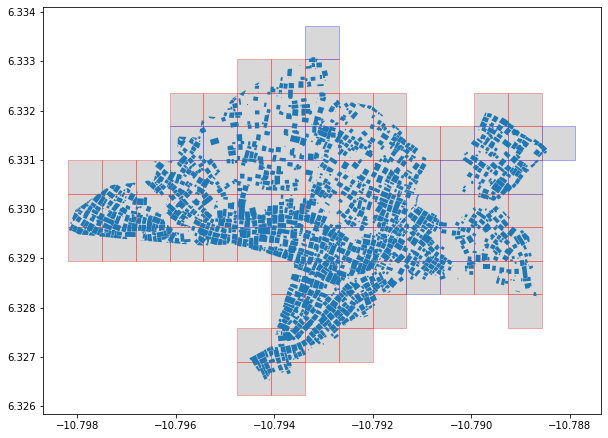

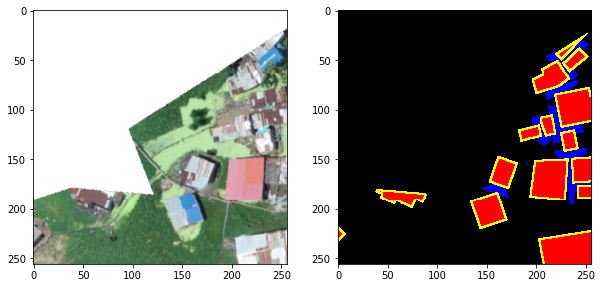

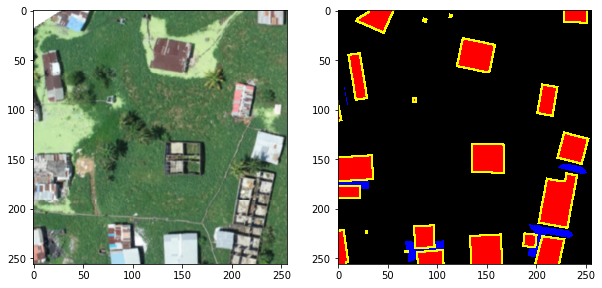

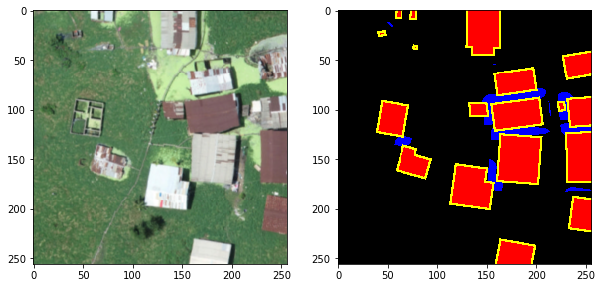

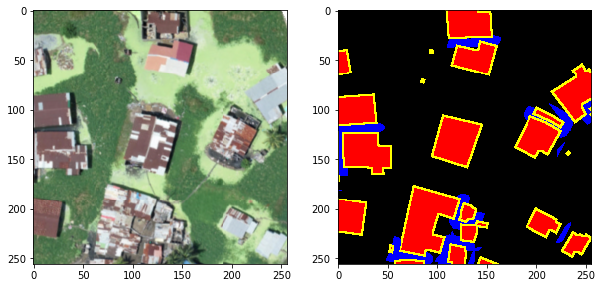

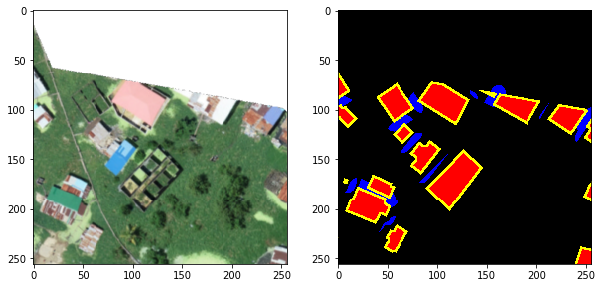




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 mon
 f15272
 iteration 18
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

2it [00:00, 16.06it/s]

3it [00:00, 10.96it/s]

4it [00:00,  9.88it/s]

5it [00:00,  7.85it/s]

7it [00:00,  9.48it/s]

8it [00:00,  8.34it/s]

9it [00:00,  8.47it/s]

10it [00:01,  5.33it/s]

12it [00:01,  6.08it/s]

13it [00:01,  6.76it/s]

14it [00:01,  7.05it/s]

16it [00:01,  8.30it/s]

18it [00:02,  9.47it/s]

21it [00:02, 11.58it/s]

23it [00:02,  9.77it/s]

25it [00:02,  9.16it/s]

27it [00:02,  9.70it/s]

29it [00:03,  9.56it/s]

31it [00:03,  9.75it/s]

33it [00:03, 11.07it/s]

35it [00:03,  9.80it/s]

37it [00:03,  9.64it/s]

39it [00:04,  9.80it/s]

41it [00:04,  9.93it/s]

43it [00:04,  9.69it/s]

45it [00:04, 11.02it/s]

47it [00:04,  9.42it/s]

49it [00:05,  9.88it/s]

51it [00:05,  9.97it/s]

53it [00:05, 10.18it/s]

55it [00:05, 10.45it/s]

57it [00:05, 11.37it/s]

59it [00:06, 10.33it/s]

61it [00:06,  9.87it/s]

63it [00:06, 10.05it/s]

65it [00:06,  9.47it/s]

68it [00:06, 10.44it/s]

70it [00:07,  9.24it/s]

71it [00:07,  9.13it/s]

73it [00:0

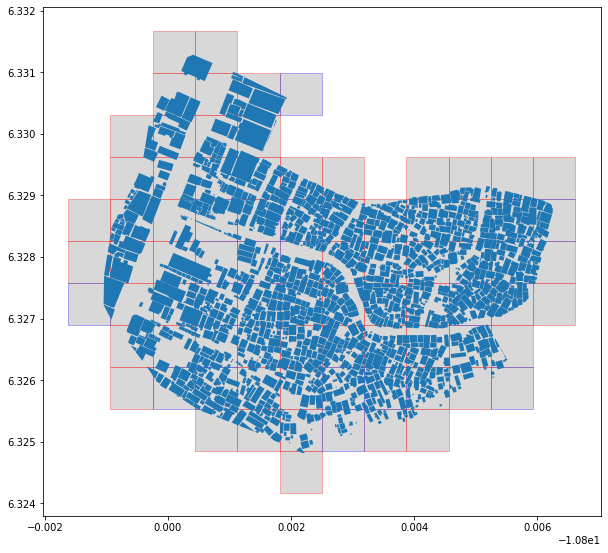

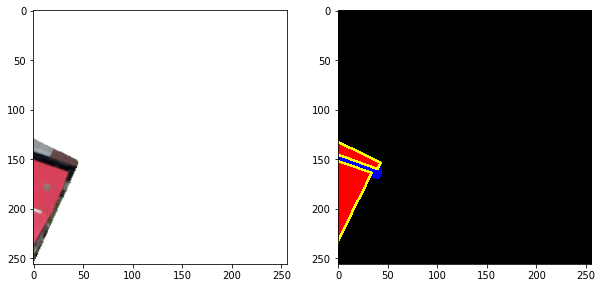

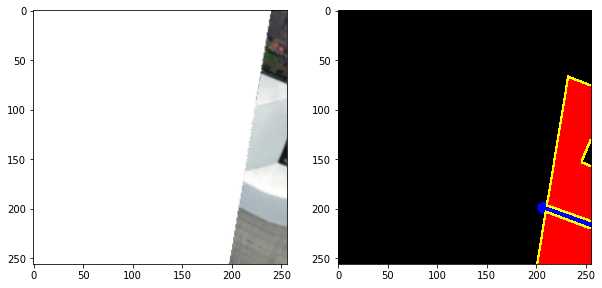

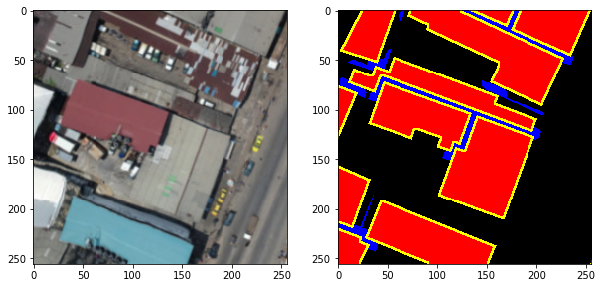

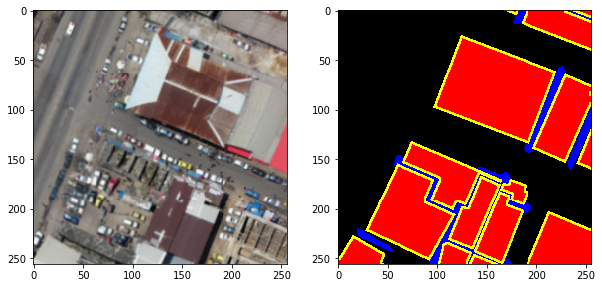

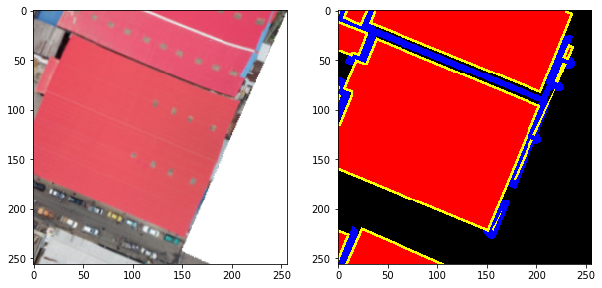




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 mon
 493701
 iteration 19
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

3it [00:00, 15.44it/s]

4it [00:00,  9.93it/s]

6it [00:00, 10.42it/s]

7it [00:00,  9.99it/s]

8it [00:00,  9.06it/s]

9it [00:01,  6.43it/s]

11it [00:01,  7.68it/s]

13it [00:01,  8.39it/s]

15it [00:01,  9.03it/s]

16it [00:01,  8.20it/s]

18it [00:01,  9.36it/s]

20it [00:02,  9.05it/s]

21it [00:02,  9.23it/s]

22it [00:02,  9.07it/s]

23it [00:02,  7.82it/s]

24it [00:02,  7.84it/s]

25it [00:02,  7.71it/s]

26it [00:02,  8.18it/s]

28it [00:03,  8.87it/s]

29it [00:03,  8.69it/s]

31it [00:03,  9.17it/s]

32it [00:03,  8.34it/s]

33it [00:03,  6.82it/s]

34it [00:03,  5.97it/s]

35it [00:04,  5.43it/s]

36it [00:04,  5.11it/s]

38it [00:04,  6.45it/s]

39it [00:04,  6.98it/s]

40it [00:04,  7.52it/s]

41it [00:04,  7.93it/s]

42it [00:04,  8.41it/s]

43it [00:05,  8.49it/s]

44it [00:05,  7.48it/s]

45it [00:05,  6.68it/s]

46it [00:05,  5.95it/s]

47it [00:05,  5.34it/s]

48it [00:06,  5.10it/s]

49it [00:06,  5.78it/s]

51it [00:06,  6.66it/s]

52it [00:

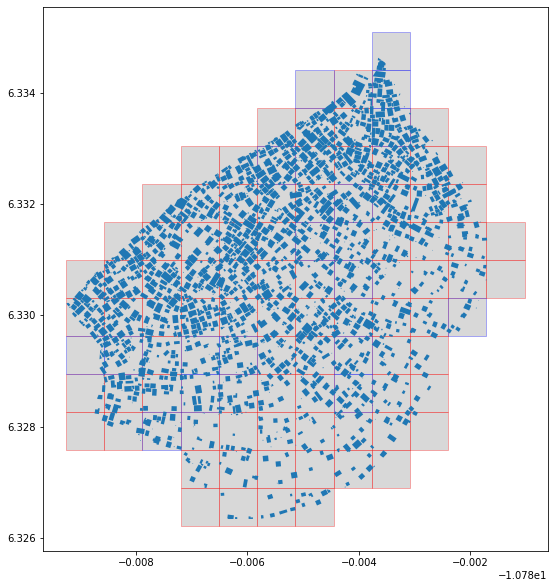

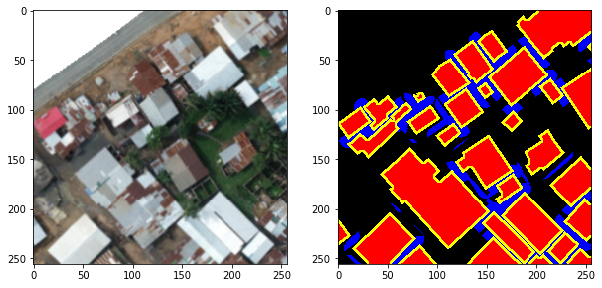

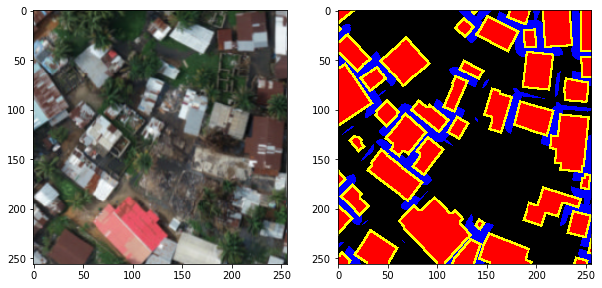

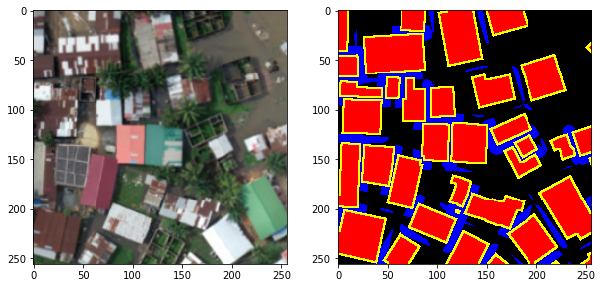

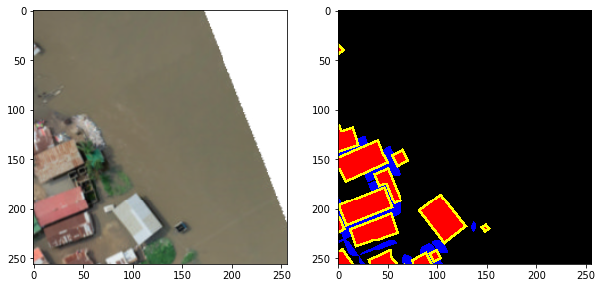

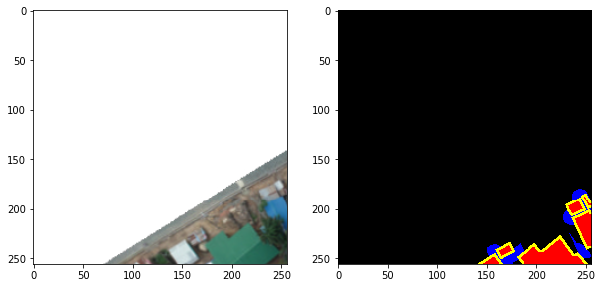




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 nia
 825a50
 iteration 20
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

2it [00:00, 10.90it/s]

3it [00:00, 10.48it/s]

4it [00:00,  9.99it/s]

6it [00:00, 10.02it/s]

7it [00:00,  9.79it/s]

8it [00:00,  9.14it/s]

9it [00:00,  8.77it/s]

10it [00:01,  8.36it/s]

11it [00:01,  8.61it/s]

12it [00:01,  8.93it/s]

13it [00:01,  8.78it/s]

14it [00:01,  8.77it/s]

15it [00:01,  8.77it/s]

16it [00:01,  9.09it/s]

17it [00:01,  9.10it/s]

18it [00:01,  9.19it/s]

19it [00:02,  9.07it/s]

20it [00:02,  8.95it/s]

21it [00:02,  8.70it/s]

22it [00:02,  8.96it/s]

23it [00:02,  9.14it/s]

24it [00:02,  9.14it/s]

25it [00:02,  8.64it/s]

26it [00:02,  8.88it/s]

27it [00:02,  9.03it/s]

28it [00:03,  8.68it/s]

29it [00:03,  8.53it/s]

31it [00:03,  8.98it/s]

33it [00:03,  9.17it/s]

34it [00:03,  9.31it/s]

35it [00:03,  9.11it/s]

36it [00:03,  9.27it/s]

38it [00:04,  9.62it/s]

39it [00:04,  9.40it/s]

40it [00:04,  8.25it/s]

41it [00:04,  8.56it/s]

42it [00:04,  8.77it/s]

43it [00:04,  9.01it/s]

44it [00:04,  9.04it/s]

45it [00:0

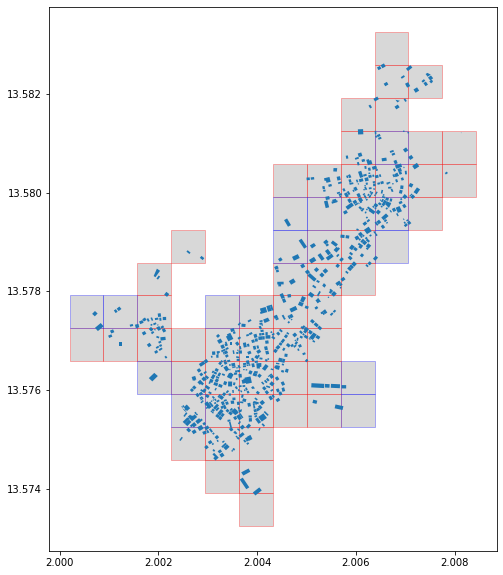

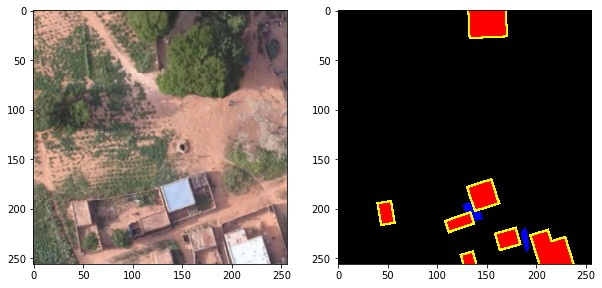

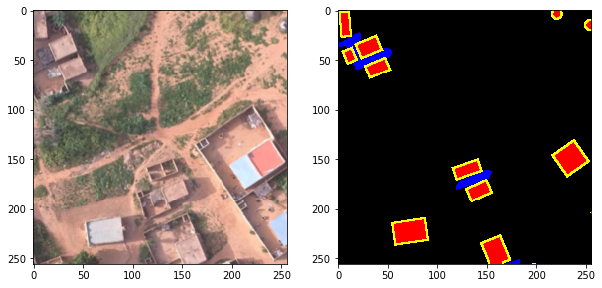

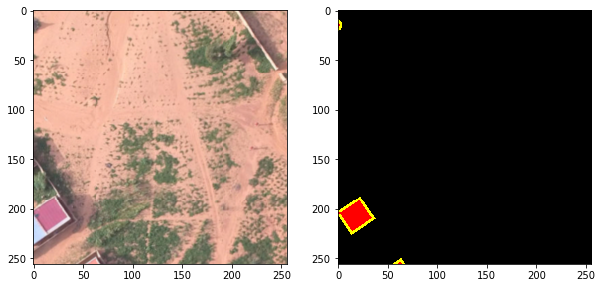

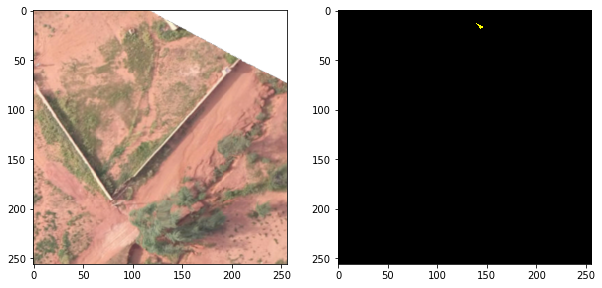

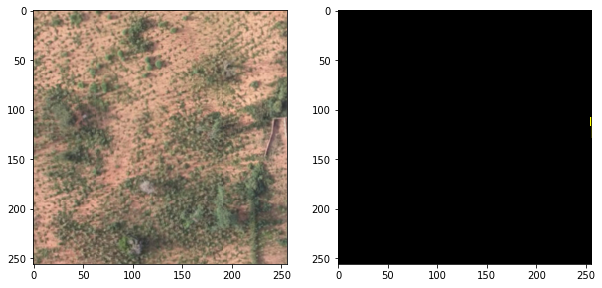




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 dar
 353093
 iteration 21
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

1it [00:00,  7.09it/s]

2it [00:00,  7.25it/s]

3it [00:00,  7.36it/s]

4it [00:00,  7.40it/s]

5it [00:00,  7.71it/s]

6it [00:00,  6.77it/s]

7it [00:00,  7.41it/s]

9it [00:01,  8.02it/s]

10it [00:01,  8.04it/s]

11it [00:01,  8.06it/s]

12it [00:01,  7.86it/s]

13it [00:01,  7.28it/s]

14it [00:01,  6.89it/s]

16it [00:02,  7.59it/s]

17it [00:02,  7.70it/s]

18it [00:02,  7.87it/s]

19it [00:02,  8.13it/s]

20it [00:02,  8.46it/s]

21it [00:02,  8.62it/s]

22it [00:02,  8.59it/s]

23it [00:02,  8.59it/s]

25it [00:03,  9.19it/s]

26it [00:03,  8.93it/s]

27it [00:03,  8.59it/s]

28it [00:03,  8.19it/s]

29it [00:03,  8.23it/s]

30it [00:03,  8.46it/s]

31it [00:03,  8.50it/s]

32it [00:03,  8.66it/s]

33it [00:03,  8.86it/s]

34it [00:04,  8.46it/s]

35it [00:04,  8.45it/s]

36it [00:04,  8.57it/s]

37it [00:04,  8.68it/s]

38it [00:04,  8.52it/s]

39it [00:04,  8.30it/s]

40it [00:04,  8.48it/s]

41it [00:04,  8.71it/s]

42it [00:05,  8.86it/s]

43it [00:05

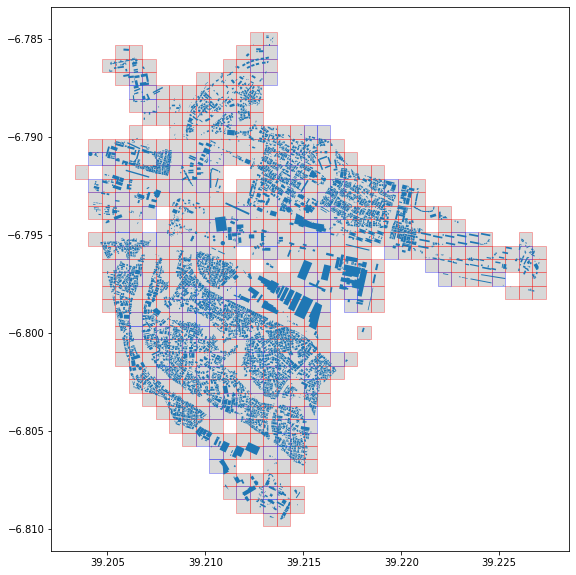

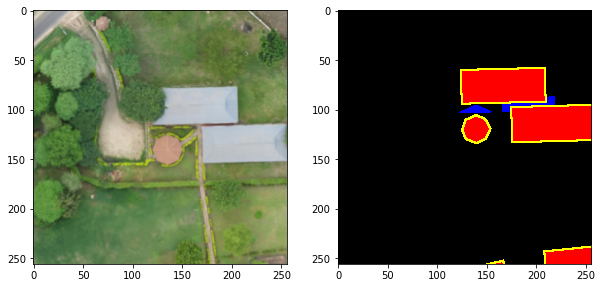

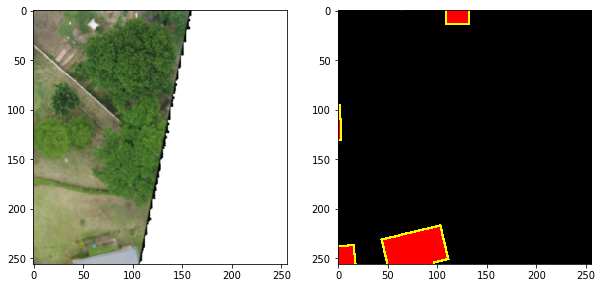

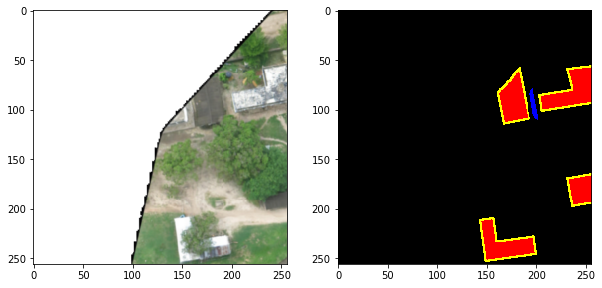

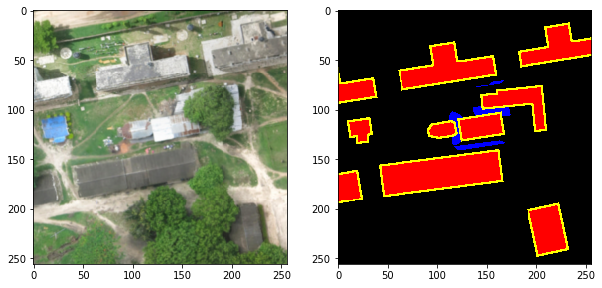

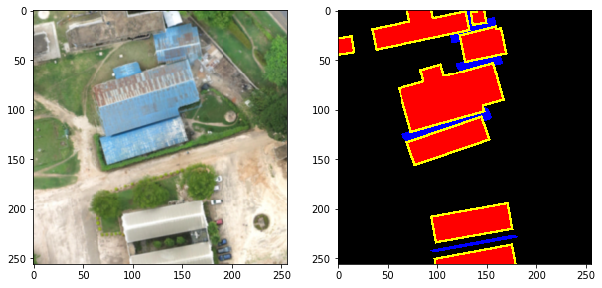




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 dar
 0a4c40
 iteration 22
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

2it [00:00, 13.58it/s]

3it [00:00, 12.02it/s]

4it [00:00, 10.65it/s]

5it [00:00,  9.90it/s]

6it [00:00,  8.73it/s]

7it [00:00,  8.61it/s]

8it [00:00,  8.68it/s]

9it [00:00,  8.44it/s]

10it [00:01,  8.65it/s]

11it [00:01,  8.10it/s]

12it [00:01,  8.53it/s]

13it [00:01,  8.30it/s]

14it [00:01,  8.66it/s]

15it [00:01,  8.45it/s]

17it [00:01,  8.79it/s]

18it [00:02,  8.34it/s]

19it [00:02,  7.84it/s]

20it [00:02,  7.56it/s]

21it [00:02,  7.17it/s]

22it [00:02,  7.16it/s]

23it [00:02,  7.46it/s]

24it [00:02,  7.47it/s]

25it [00:03,  7.65it/s]

26it [00:03,  7.85it/s]

27it [00:03,  7.91it/s]

28it [00:03,  7.57it/s]

29it [00:03,  7.05it/s]

30it [00:03,  7.00it/s]

31it [00:03,  6.21it/s]

32it [00:04,  5.58it/s]

33it [00:04,  5.76it/s]

34it [00:04,  5.95it/s]

35it [00:04,  6.26it/s]

36it [00:04,  5.53it/s]

37it [00:05,  4.91it/s]

38it [00:05,  5.14it/s]

39it [00:05,  5.54it/s]

40it [00:05,  5.82it/s]

41it [00:05,  5.94it/s]

42it [00:05

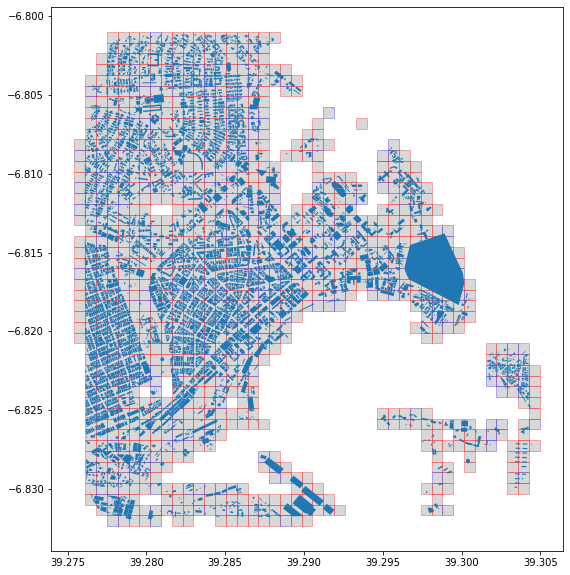

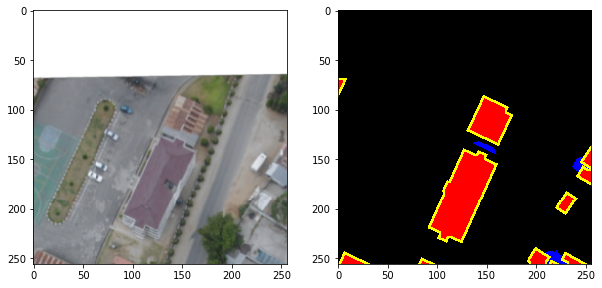

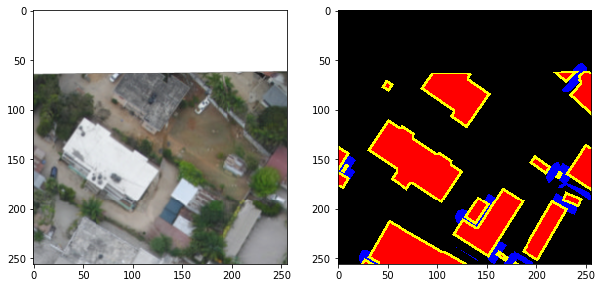

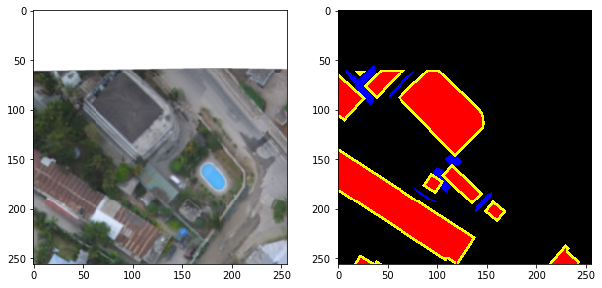

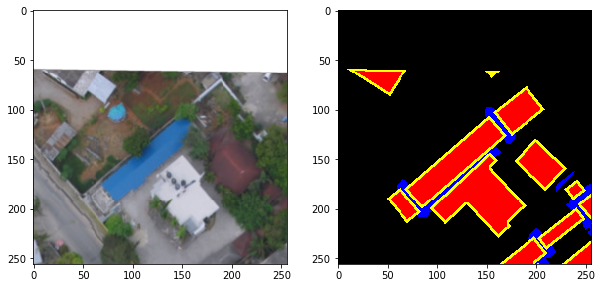

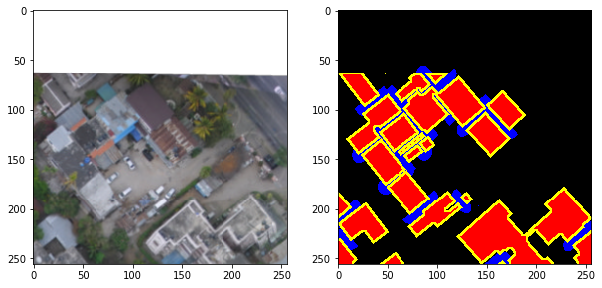




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 dar
 b15fce
 iteration 23
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

3it [00:00, 17.04it/s]

4it [00:00, 13.05it/s]

5it [00:00,  6.08it/s]

6it [00:00,  6.71it/s]

8it [00:00,  7.64it/s]

10it [00:01,  9.06it/s]

12it [00:01, 10.39it/s]

14it [00:01,  9.84it/s]

16it [00:01,  9.75it/s]

18it [00:01,  9.57it/s]

20it [00:02,  9.17it/s]

21it [00:02,  8.86it/s]

22it [00:02,  8.94it/s]

24it [00:02,  9.36it/s]

26it [00:02, 10.44it/s]

28it [00:02, 11.88it/s]

30it [00:03, 10.34it/s]

32it [00:03, 10.28it/s]

34it [00:03, 10.04it/s]

36it [00:03,  9.69it/s]

38it [00:03,  9.63it/s]

39it [00:03,  9.57it/s]

40it [00:04,  9.11it/s]

41it [00:04,  9.02it/s]

42it [00:04,  8.48it/s]

43it [00:04,  8.56it/s]

44it [00:04,  7.93it/s]

45it [00:04,  8.36it/s]

47it [00:04,  9.62it/s]

50it [00:05, 10.69it/s]

52it [00:05, 10.58it/s]

54it [00:05, 10.40it/s]

56it [00:05, 10.04it/s]

58it [00:05,  9.90it/s]

60it [00:06,  9.63it/s]

61it [00:06,  9.61it/s]

62it [00:06,  9.49it/s]

63it [00:06,  9.15it/s]

64it [00:06,  9.34it/s]

65it [00

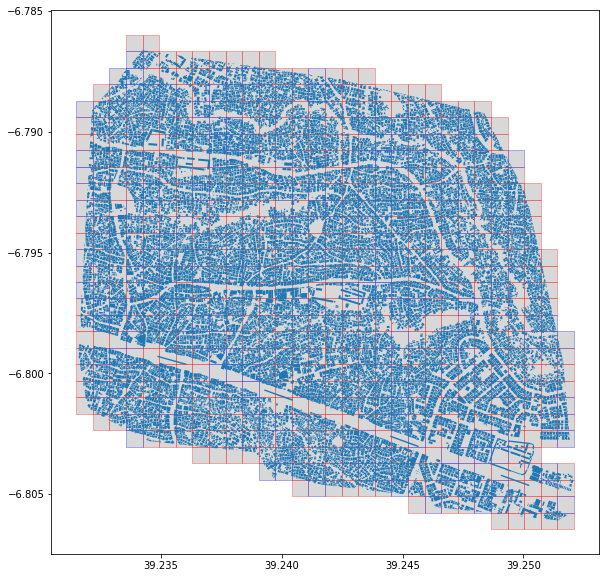

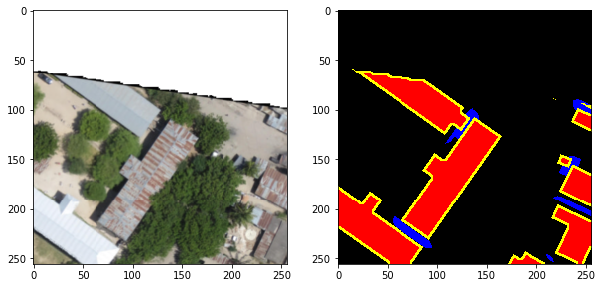

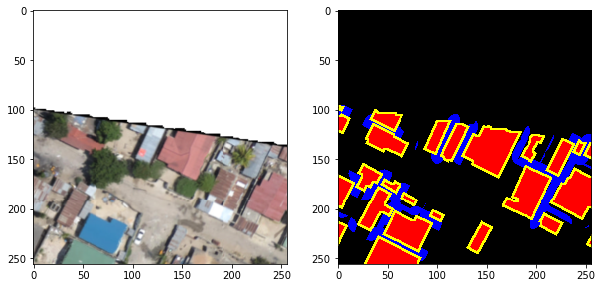

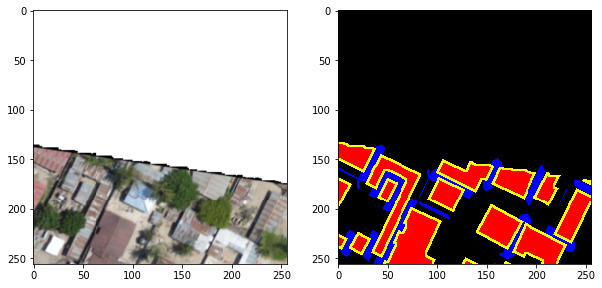

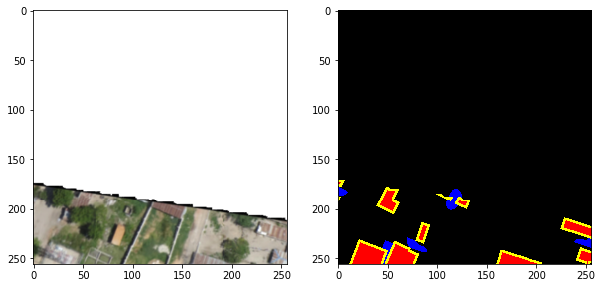

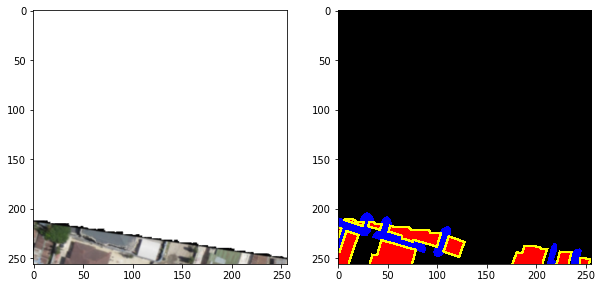




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 dar
 f883a0
 iteration 24
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

2it [00:00, 19.95it/s]

4it [00:00, 18.38it/s]

6it [00:00, 16.68it/s]

8it [00:00, 14.88it/s]

10it [00:00, 13.63it/s]

12it [00:00, 12.26it/s]

14it [00:01, 11.86it/s]

16it [00:01, 10.82it/s]

18it [00:01, 10.43it/s]

20it [00:01, 10.68it/s]

22it [00:01, 10.16it/s]

24it [00:02, 10.25it/s]

26it [00:02, 10.11it/s]

28it [00:02, 10.53it/s]

30it [00:02, 11.42it/s]

32it [00:02, 12.56it/s]

34it [00:02, 11.61it/s]

36it [00:03, 10.96it/s]

38it [00:03, 10.15it/s]

40it [00:03,  9.59it/s]

41it [00:03,  8.63it/s]

42it [00:03,  8.54it/s]

43it [00:04,  8.52it/s]

44it [00:04,  8.31it/s]

45it [00:04,  8.08it/s]

46it [00:04,  8.04it/s]

47it [00:04,  7.84it/s]

48it [00:04,  7.90it/s]

49it [00:04,  7.57it/s]

50it [00:04,  7.26it/s]

51it [00:05,  7.06it/s]

52it [00:05,  6.35it/s]

53it [00:05,  6.40it/s]

54it [00:05,  6.52it/s]

55it [00:05,  6.63it/s]

56it [00:05,  6.81it/s]

57it [00:06,  6.83it/s]

58it [00:06,  7.02it/s]

59it [00:06,  7.33it/s]

60it [0

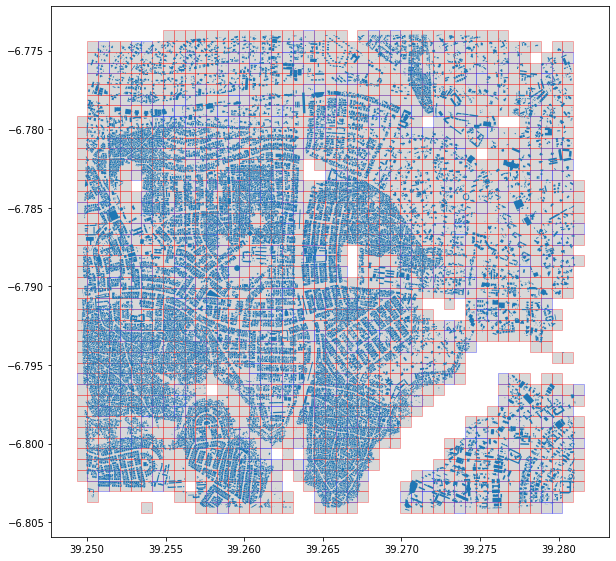

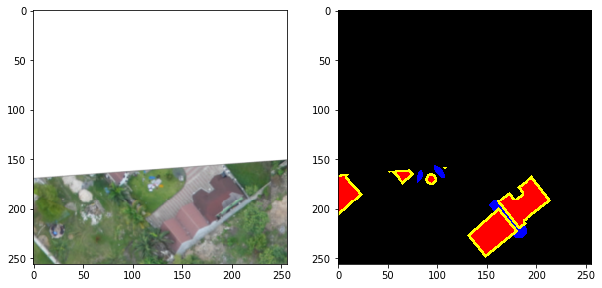

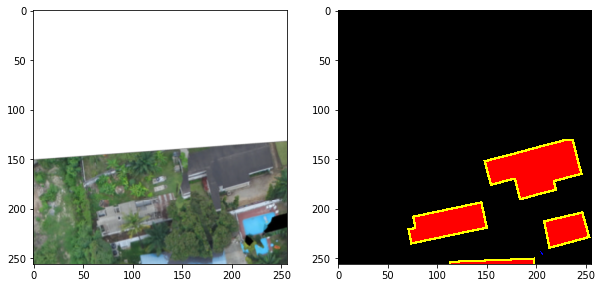

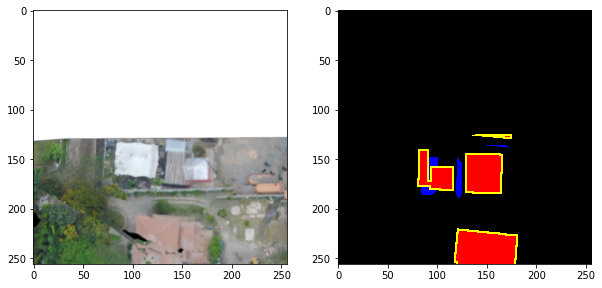

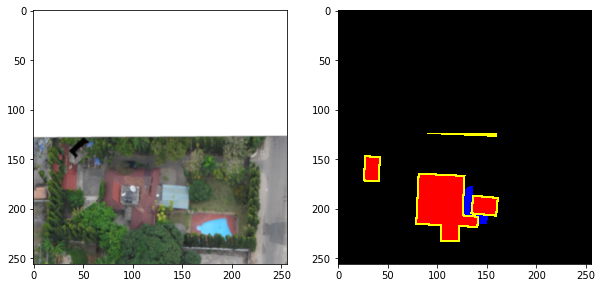

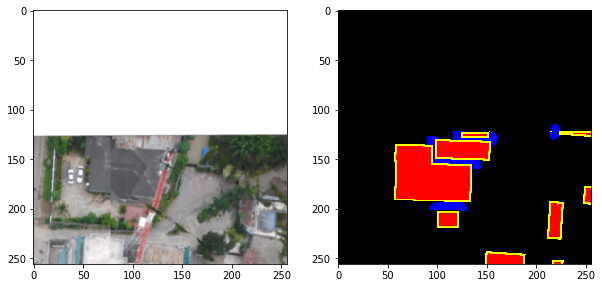




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 dar
 42f235
 iteration 25
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

2it [00:00, 16.61it/s]

4it [00:00, 16.63it/s]

6it [00:00, 16.00it/s]

8it [00:00, 16.31it/s]

10it [00:00, 16.68it/s]

12it [00:00, 17.10it/s]

14it [00:00, 17.64it/s]

17it [00:00, 18.54it/s]

20it [00:01, 18.76it/s]

23it [00:01, 21.02it/s]

26it [00:01, 16.75it/s]

28it [00:01, 11.62it/s]

30it [00:02, 10.46it/s]

32it [00:02,  7.70it/s]

34it [00:02,  7.54it/s]

35it [00:02,  7.42it/s]

36it [00:02,  7.73it/s]

37it [00:03,  7.28it/s]

38it [00:03,  7.13it/s]

39it [00:03,  7.61it/s]

40it [00:03,  7.51it/s]

41it [00:03,  7.17it/s]

42it [00:03,  6.99it/s]

43it [00:04,  6.55it/s]

44it [00:04,  7.18it/s]

45it [00:04,  7.69it/s]

46it [00:04,  7.99it/s]

47it [00:04,  8.22it/s]

48it [00:04,  8.60it/s]

49it [00:04,  8.85it/s]

50it [00:04,  8.44it/s]

51it [00:04,  7.91it/s]

52it [00:05,  7.48it/s]

53it [00:05,  6.46it/s]

54it [00:05,  6.13it/s]

55it [00:05,  6.39it/s]

56it [00:05,  6.32it/s]

57it [00:05,  6.49it/s]

58it [00:06,  5.29it/s]

59it [0

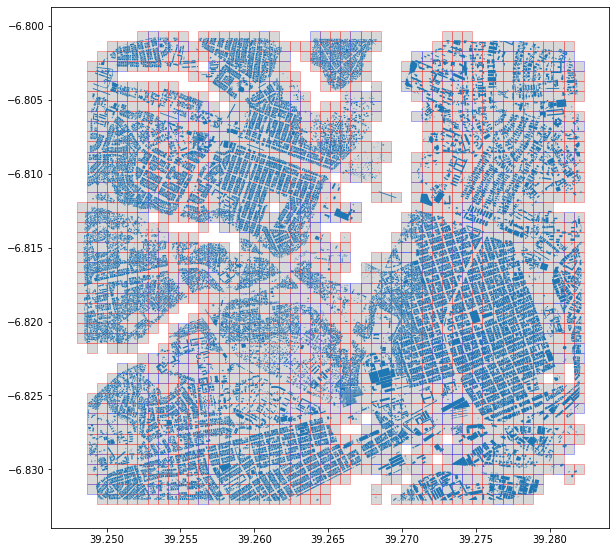

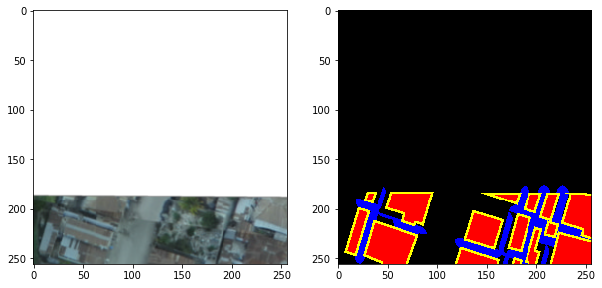

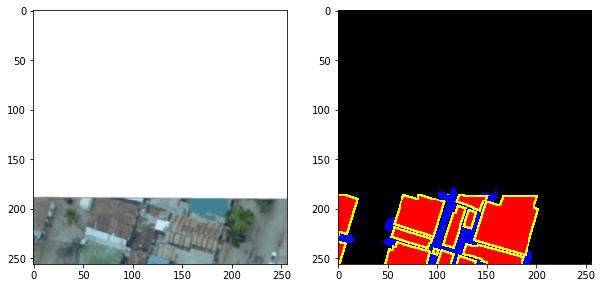

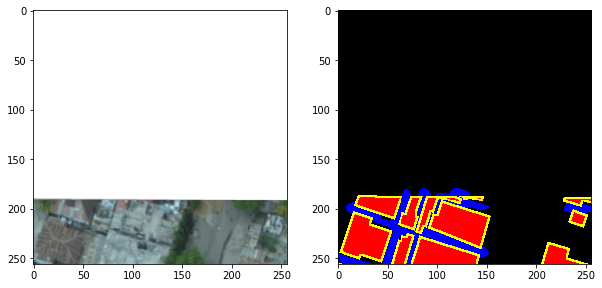

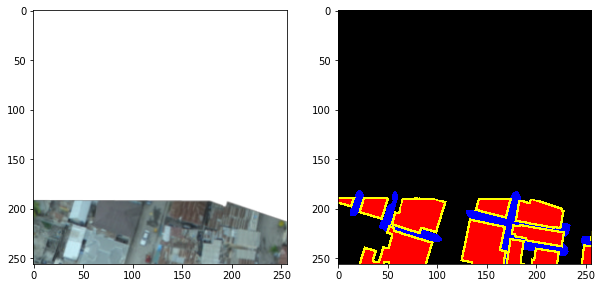

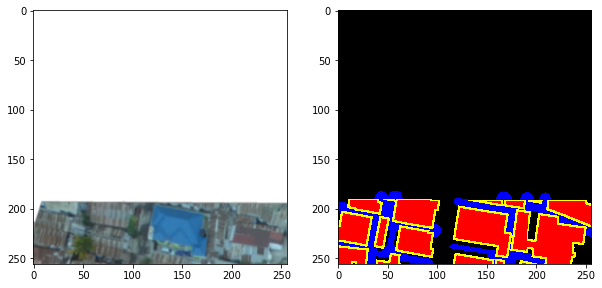




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 dar
 a017f9
 iteration 26
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

2it [00:00, 16.36it/s]

4it [00:00, 17.30it/s]

5it [00:00,  8.59it/s]

6it [00:00,  6.56it/s]

7it [00:00,  6.58it/s]

8it [00:00,  7.02it/s]

9it [00:01,  7.62it/s]

11it [00:01,  8.42it/s]

12it [00:01,  8.68it/s]

14it [00:01,  9.63it/s]

16it [00:01,  7.52it/s]

17it [00:02,  6.47it/s]

18it [00:02,  6.56it/s]

19it [00:02,  7.29it/s]

20it [00:02,  7.49it/s]

21it [00:02,  8.05it/s]

22it [00:02,  8.14it/s]

23it [00:02,  8.46it/s]

24it [00:02,  8.76it/s]

26it [00:03,  9.33it/s]

28it [00:03,  9.97it/s]

30it [00:03,  9.08it/s]

31it [00:03,  8.62it/s]

32it [00:03,  8.49it/s]

33it [00:03,  8.45it/s]

34it [00:04,  8.00it/s]

35it [00:04,  8.25it/s]

36it [00:04,  8.34it/s]

37it [00:04,  7.93it/s]

38it [00:04,  8.06it/s]

39it [00:04,  8.51it/s]

40it [00:04,  8.85it/s]

41it [00:04,  8.96it/s]

42it [00:04,  8.79it/s]

43it [00:05,  8.97it/s]

45it [00:05,  9.66it/s]

47it [00:05, 10.05it/s]

49it [00:05, 10.46it/s]

51it [00:05,  9.96it/s]

53it [00:0

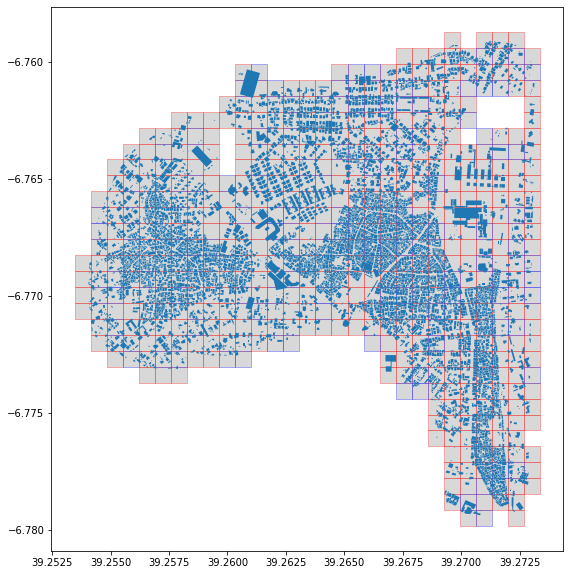

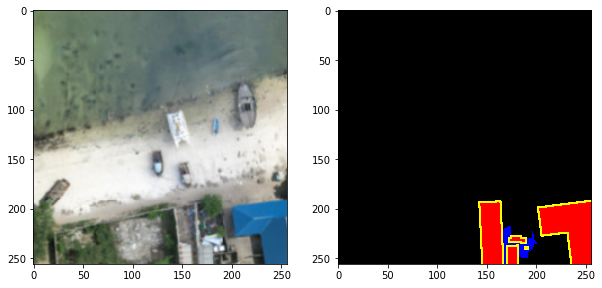

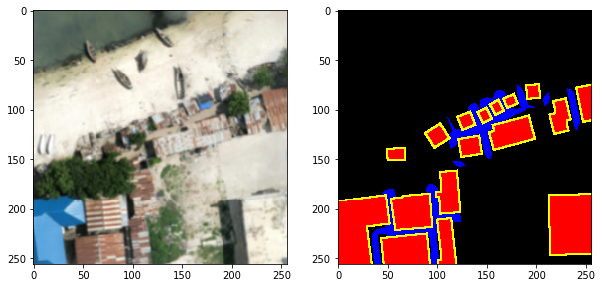

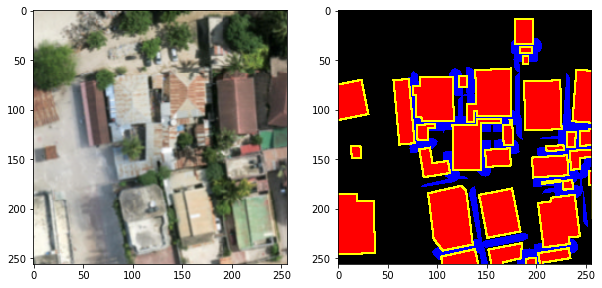

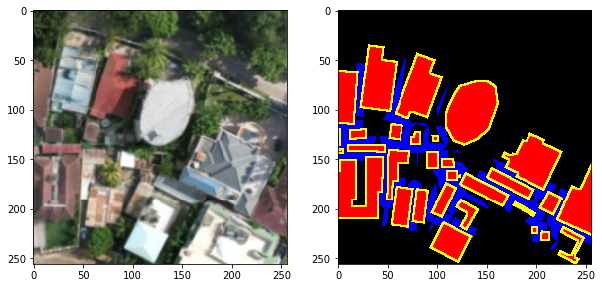

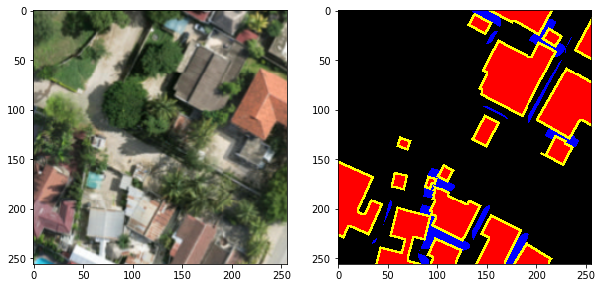




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 acc
 a42435
 iteration 27
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

2it [00:00, 16.94it/s]

4it [00:00, 15.98it/s]

6it [00:00, 14.60it/s]

8it [00:00, 15.45it/s]

10it [00:00, 14.18it/s]

12it [00:00, 12.98it/s]

14it [00:01, 11.86it/s]

16it [00:01, 12.05it/s]

18it [00:01, 12.31it/s]

20it [00:01, 11.27it/s]

22it [00:01, 10.40it/s]

24it [00:02,  9.15it/s]

25it [00:02,  8.53it/s]

26it [00:02,  6.75it/s]

27it [00:02,  7.18it/s]

28it [00:02,  7.57it/s]

29it [00:02,  8.06it/s]

30it [00:02,  8.41it/s]

31it [00:03,  8.58it/s]

32it [00:03,  8.91it/s]

33it [00:03,  8.98it/s]

34it [00:03,  8.73it/s]

35it [00:03,  8.64it/s]

36it [00:03,  8.80it/s]

37it [00:03,  8.78it/s]

38it [00:03,  8.80it/s]

39it [00:03,  8.82it/s]

40it [00:04,  8.86it/s]

41it [00:04,  8.41it/s]

42it [00:04,  8.22it/s]

43it [00:04,  7.71it/s]

44it [00:04,  7.12it/s]

45it [00:04,  6.73it/s]

46it [00:04,  6.37it/s]

47it [00:05,  7.02it/s]

49it [00:05,  8.09it/s]

50it [00:05,  8.42it/s]

51it [00:05,  8.55it/s]

52it [00:05,  8.68it/s]

53it [0

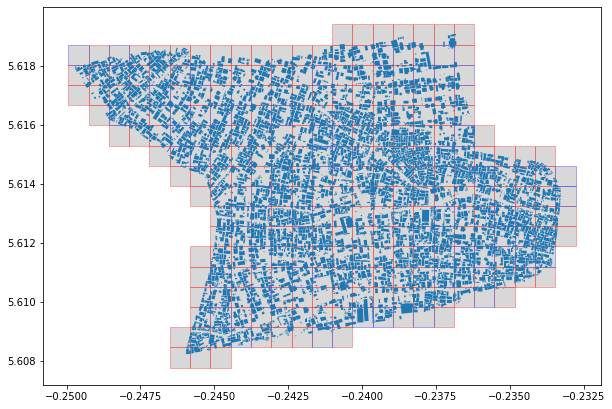

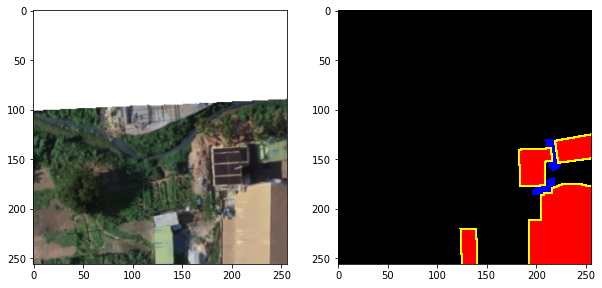

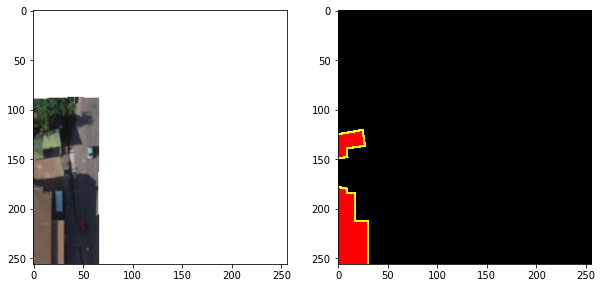

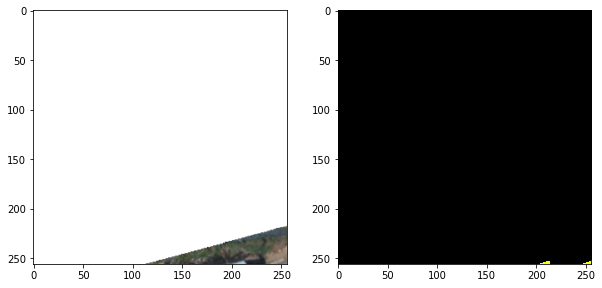

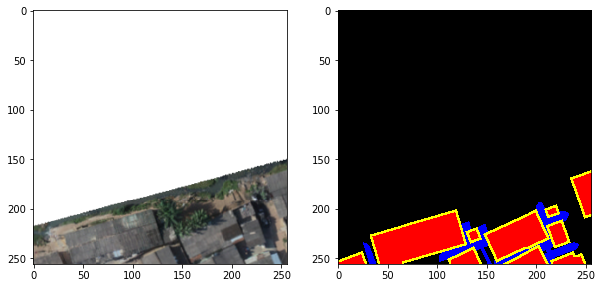

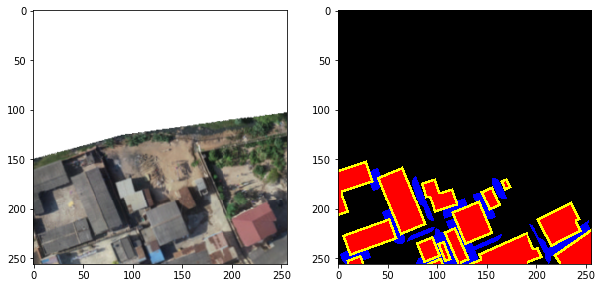




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 acc
 d41d81
 iteration 28
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

2it [00:00, 13.73it/s]

4it [00:00, 13.69it/s]

5it [00:00, 11.31it/s]

6it [00:00, 10.64it/s]

7it [00:00,  9.46it/s]

9it [00:00, 10.97it/s]

11it [00:00, 10.26it/s]

13it [00:01, 10.81it/s]

15it [00:01,  9.71it/s]

16it [00:01,  8.91it/s]

18it [00:01, 10.18it/s]

20it [00:01,  9.81it/s]

22it [00:02,  9.69it/s]

24it [00:02,  9.17it/s]

25it [00:02,  8.90it/s]

26it [00:02,  8.49it/s]

27it [00:02,  8.13it/s]

29it [00:02,  9.34it/s]

31it [00:03,  9.30it/s]

32it [00:03,  8.85it/s]

33it [00:03,  8.33it/s]

34it [00:03,  8.26it/s]

35it [00:03,  8.28it/s]

36it [00:03,  8.05it/s]

37it [00:03,  8.10it/s]

38it [00:03,  7.88it/s]

39it [00:04,  7.50it/s]

40it [00:04,  7.57it/s]

42it [00:04,  9.12it/s]

44it [00:04, 10.66it/s]

46it [00:04, 10.34it/s]

48it [00:04, 10.29it/s]

50it [00:05,  9.35it/s]

52it [00:05,  9.06it/s]

53it [00:05,  8.67it/s]

54it [00:05,  8.45it/s]

55it [00:05,  7.97it/s]

56it [00:05,  8.08it/s]

57it [00:06,  7.89it/s]

58it [00:

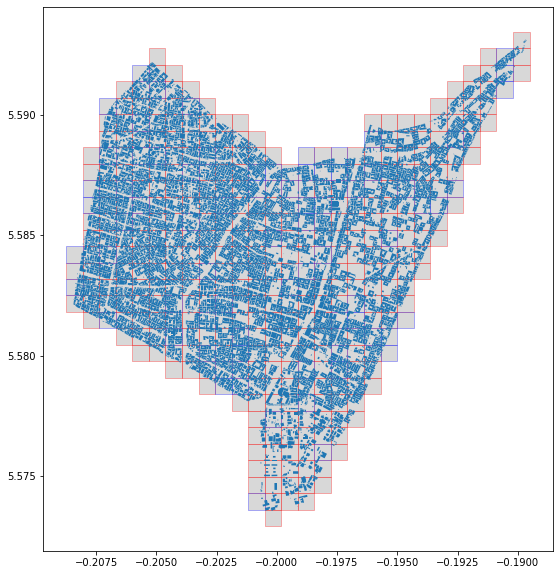

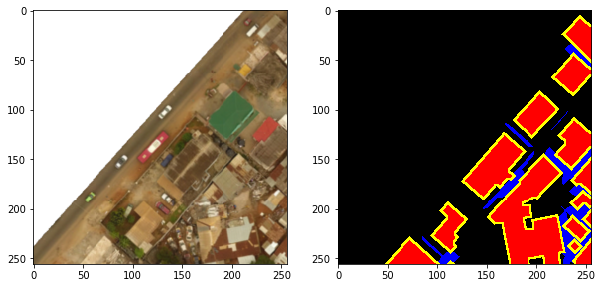

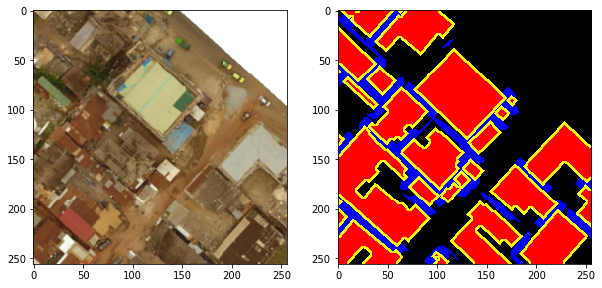

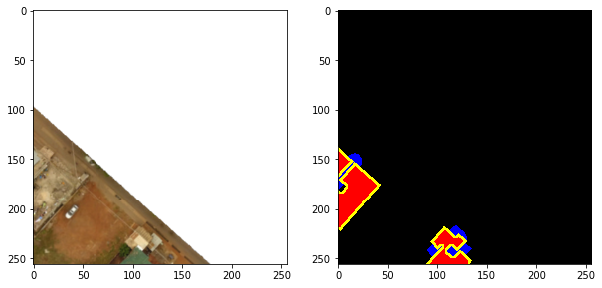

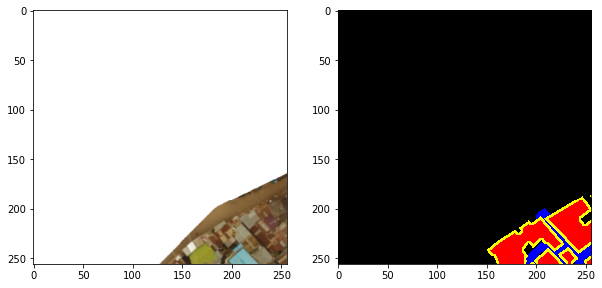

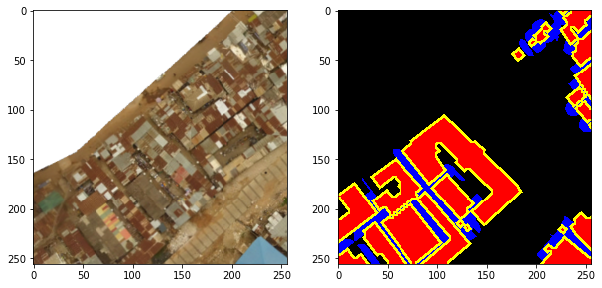




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 acc
 665946
 iteration 29
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

1it [00:00,  9.57it/s]

3it [00:00, 10.40it/s]

5it [00:00, 11.33it/s]

6it [00:00,  9.58it/s]

7it [00:00,  9.39it/s]

9it [00:00,  9.80it/s]

10it [00:00,  9.50it/s]

11it [00:01,  9.12it/s]

12it [00:01,  8.84it/s]

15it [00:01, 10.13it/s]

17it [00:01, 10.11it/s]

19it [00:01, 10.39it/s]

21it [00:01, 10.24it/s]

23it [00:02,  9.79it/s]

24it [00:02,  9.31it/s]

25it [00:02,  9.29it/s]

27it [00:02,  9.56it/s]

28it [00:02,  8.89it/s]

29it [00:02,  9.14it/s]

30it [00:02,  8.34it/s]

31it [00:03,  8.44it/s]

32it [00:03,  8.85it/s]

33it [00:03,  8.62it/s]

35it [00:03, 10.00it/s]

37it [00:03,  9.00it/s]

38it [00:03,  7.37it/s]

39it [00:04,  7.50it/s]

40it [00:04,  7.79it/s]

41it [00:04,  7.94it/s]

42it [00:04,  8.21it/s]

43it [00:04,  8.64it/s]

45it [00:04,  9.46it/s]

46it [00:04,  8.69it/s]

47it [00:04,  8.84it/s]

48it [00:05,  8.66it/s]

49it [00:05,  8.46it/s]

51it [00:05,  8.78it/s]

52it [00:05,  9.06it/s]

53it [00:05,  8.59it/s]

55it [00:

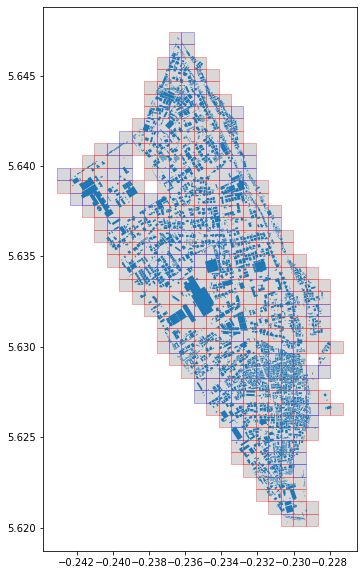

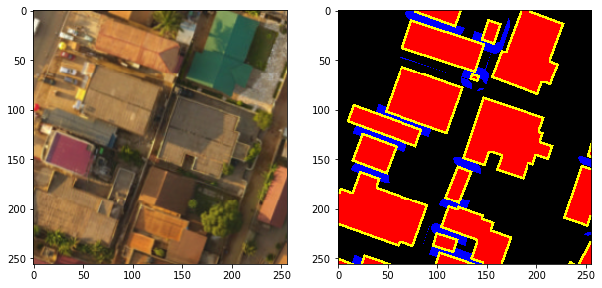

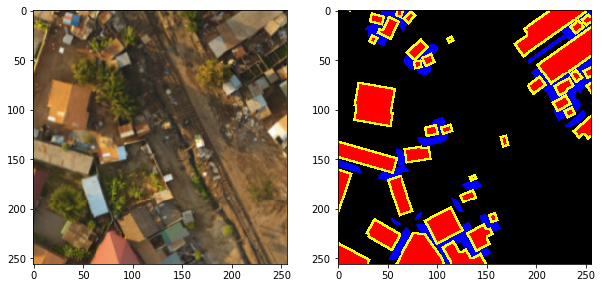

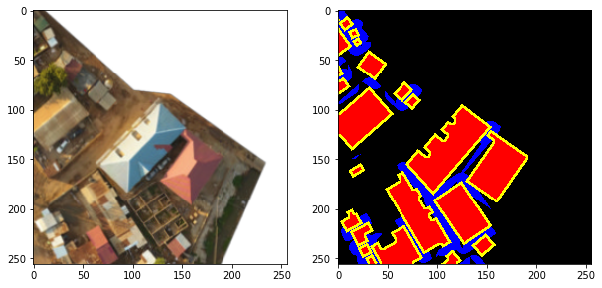

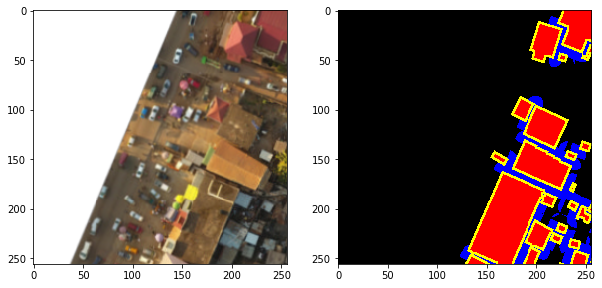

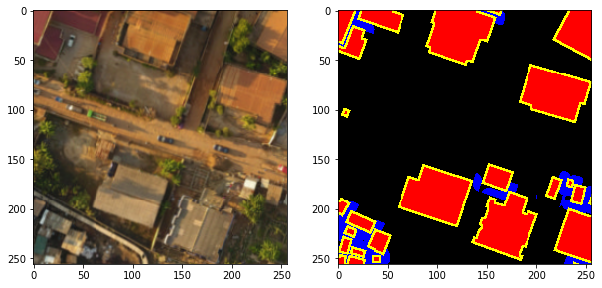




!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
 Starting
 acc
 ca041a
 iteration 30
 !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!




0it [00:00, ?it/s]

2it [00:00, 13.18it/s]

3it [00:00, 11.05it/s]

5it [00:00, 11.21it/s]

7it [00:00, 10.99it/s]

8it [00:00,  9.39it/s]

9it [00:00,  8.71it/s]

10it [00:01,  8.78it/s]

12it [00:01,  9.08it/s]

13it [00:01,  9.33it/s]

14it [00:01,  8.91it/s]

16it [00:01,  9.57it/s]

17it [00:01,  8.93it/s]

18it [00:01,  9.12it/s]

19it [00:01,  9.07it/s]

20it [00:02,  8.75it/s]

21it [00:02,  8.31it/s]

22it [00:02,  7.91it/s]

23it [00:02,  8.38it/s]

25it [00:02,  8.08it/s]

26it [00:02,  7.51it/s]

27it [00:03,  7.70it/s]

28it [00:03,  8.05it/s]

29it [00:03,  8.50it/s]

31it [00:03,  9.36it/s]

32it [00:03,  8.31it/s]

33it [00:03,  8.33it/s]

34it [00:03,  8.16it/s]

35it [00:03,  8.40it/s]

36it [00:04,  8.69it/s]

37it [00:04,  8.85it/s]

39it [00:04,  9.32it/s]

40it [00:04,  7.97it/s]

41it [00:04,  7.75it/s]

43it [00:04,  7.98it/s]

44it [00:04,  7.77it/s]

45it [00:05,  8.01it/s]

46it [00:05,  8.32it/s]

47it [00:05,  8.40it/s]

48it [00:05,  7.87it/s]

50it [00:

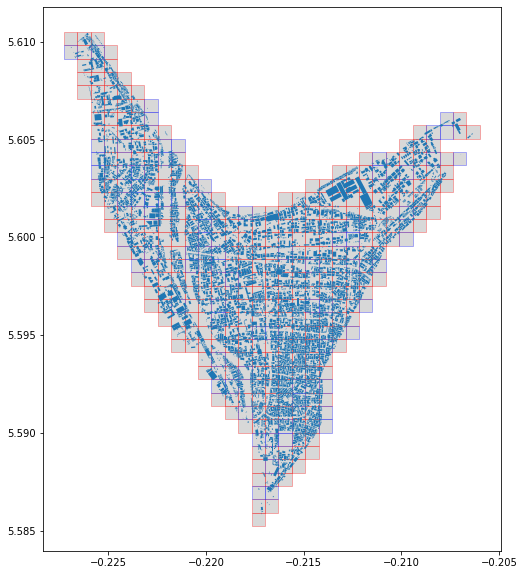

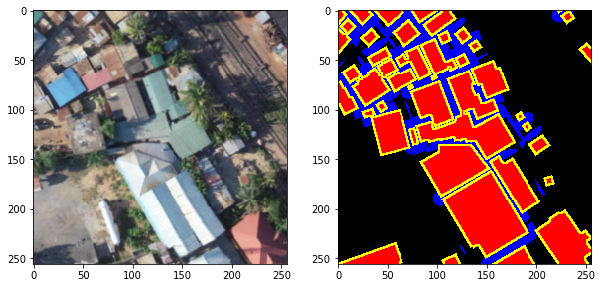

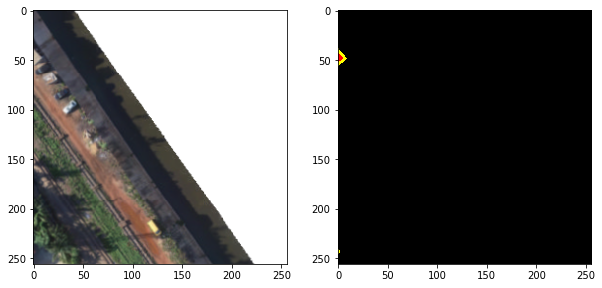

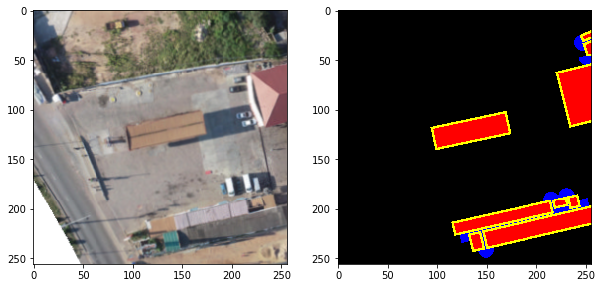

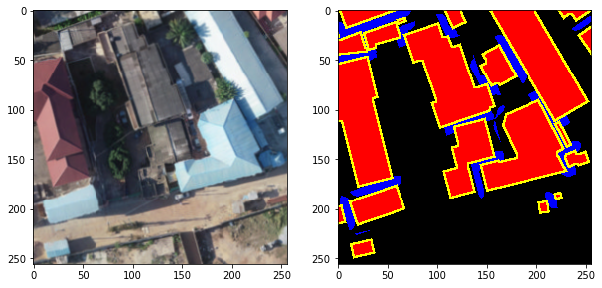

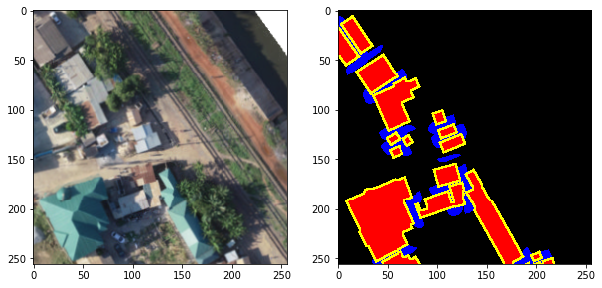

In [293]:
for i in range(len(tif_file_df['tif_file_path'])):
  label_gdf, geotif, region, zone = proc.import_data_colab(label_file_df, tif_file_df, i)

  print(f'\n\n\n!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!\n Starting\n {region}\n {zone}\n iteration {i}\n !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!')

  img_path, mask_path = proc.make_processed_directories_colab(zone = zone, region = region)
  proc.burn_tiles_colab(region = region, zone = zone, zoom_level= zoom_level)
  tiles_gdf = proc.load_tile_geojson_colab(region = region, zone = zone, visualize=False)
  tiles_gdf = proc.train_validation_split(tiles_gdf, valid_set_size=.2, visualize=False)
  # Visualize the tiles over the polygons
  vis.visualize_burned_cells(tiles_gdf, label_gdf)
  tiles_gdf = proc.reformat_xyz(tiles_gdf)

  # get the geometries from the geodataframe
  all_polys_series = label_gdf.geometry
  # preimptively fix and merge any invalid or overlapping geoms that would otherwise throw errors during the rasterize step. 
  all_polys_series = proc.cleanup_invalid_geoms(all_polys_series)

  #img_path_clean = proc.transform_paths_for_skimage(img_path)
  img_path_clean = img_path.replace('\\','')
  proc.batch_save_tile_img(tiles_gdf= tiles_gdf, tif= geotif, tile_size=256, zone=zone, 
                          region= region, save_path= img_path_clean)

  # mask_path_clean = proc.transform_paths_for_skimage(mask_path)
  mask_path_clean = mask_path.replace('\\','')
  proc.batch_save_tile_mask(tiles_gdf= tiles_gdf, label_poly_series= all_polys_series, tile_size= 256, region= region,
                          zone= zone, save_path= mask_path_clean, channels=3, display=False)
  df_filepaths = proc.make_filepath_df(img_path_clean)
  df_filepaths.head()
  vis.visualize_saved_tiles(5,10, df_filepaths)